# New CVID data

### Analysis based on GEX and SoupX-denoised protein

12.2020

(Preprocessing happened in notebook M1)

Step-by-step workflow - **different to the scRNA-seq integration in doublet calling**:
- load preprocessed object
- do SCTransfor instead of normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- filter out cell cycle genes - taking cleaned up genes from the GEX-only object and uniting with protein features
- subset to HVGs
- (skipping scaling, not necessary because we've done SCTransform)
- pca (can also do preliminary neighbors/bbknn+umap here to peak at the data)
- **train a logreg model and add annotation (before it used to be earlier in the workflow)**
- neighbors/bbknn - deciding on which batch correction we will be using
- perform **step 2** of bertie doublet calling (requires running louvain clustering, see code)
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
# need to do 'pip3 install bbknn==1.3.8' to avoid incompatibility errors
import bbknn
# requires 'pip install scrublet'
#import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
%%bash

pip freeze

aiohttp==3.6.2
alembic==1.3.0
anndata==0.7.5
annoy==1.16.2
async-generator==1.10
async-timeout==3.0.1
attrs==19.3.0
backcall==0.1.0
bbknn==1.3.6
bleach==3.1.0
blinker==1.4
certifi==2019.9.11
certipy==0.1.3
cffi==1.13.2
chardet==3.0.4
Click==7.0
conda==4.7.12
conda-package-handling==1.6.0
cryptography==2.8
cycler==0.10.0
Cython==0.29.14
decorator==4.4.1
defusedxml==0.6.0
entrypoints==0.3
fbpca==1.0
geosketch==1.0
get-version==2.1
h5py==2.10.0
idna==2.8
importlib-metadata==0.23
intervaltree==2.1.0
ipykernel==5.1.3
ipython==7.9.0
ipython-genutils==0.2.0
jedi==0.15.1
Jinja2==2.10.3
joblib==0.14.0
json5==0.8.5
jsonschema==3.1.1
jupyter-client==5.3.3
jupyter-core==4.5.0
jupyter-rsession-proxy==1.0b6
jupyter-server-proxy==1.2.0
jupyterhub==1.0.0
jupyterlab==1.2.1
jupyterlab-server==1.0.6
kiwisolver==1.1.0
legacy-api-wrap==1.2
leidenalg==0.7.0
llvmlite==0.30.0
loompy==3.0.6
louvain==0.6.1
Mako==1.1.0
MarkupSafe==1.1.1
matplotlib==3.1.0
mistune==0.8.4
more-itertools==7.2.0
multidict==4.5.2
nats

In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.1.0
anndata             0.7.5
annoy               NA
attr                19.3.0
backcall            0.1.0
bbknn               NA
cffi                1.13.2
constants           NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.1
get_version         2.1
h5py                2.10.0
highs_wrapper       NA
igraph              0.7.1
importlib_metadata  0.23
ipykernel           5.1.3
ipython_genutils    0.2.0
jedi                0.15.1
joblib              0.14.0
kiwisolver          1.1.0
legacy_api_wrap     1.2
leidenalg           0.7.0
llvmlite            0.30.0
louvain             0.6.1
matplotlib          3.1.0
more_itertools      NA
mpl_toolkits        NA
natsort             6.2.0
numba               0.46.0
numexpr             2.7.0
numpy               1.17.4
packaging           19.2
pandas              0.25.3
parso               0.5.1
pexpect        

A Benjamini-Hochberg function for later. Running FDR is surprisingly inconvenient using built-in Python options.

In [5]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/'

## Reding the preprocessed object

Preprocessing happened in M1 notebook

In [6]:
# reading
adata = sc.read(save_path+'adata_raw_filtered_all_samples.h5ad')

In [7]:
adata.var['feature_types-0'].value_counts()

Gene Expression     17254
nan                  4698
Antibody Capture      192
Name: feature_types-0, dtype: int64

In [9]:
# reading indices of cells that were not called as doublets
indices = pd.read_csv('cells_no_doublets_GEX_only_based.csv', index_col=0)

### Reading SoupX-denoised protein data (raw)

In [10]:
samples = np.unique(adata.obs['sample'])
samples

array(['35008_CV005_RV9039258_and_35008_CV005_RV9039282',
       '35008_CV005_RV9039259_and_35008_CV005_RV9039283',
       '35008_CV005_RV9039260_and_35008_CV005_RV9039284',
       '35008_CV005_RV9039261_and_35008_CV005_RV9039285',
       '35008_CV005_RV9039262_and_35008_CV005_RV9039286',
       '35008_CV005_RV9039263_and_35008_CV005_RV9039287',
       '35008_CV005_RV9039264_and_35008_CV005_RV9039288',
       '35008_CV005_RV9039265_and_35008_CV005_RV9039289',
       '35171_CV005_RV9039361', '35171_CV005_RV9039362',
       '35171_CV005_RV9039363', '35171_CV005_RV9039364'], dtype=object)

In [12]:
# reading SoupX corrected protein counts (raw)
soupx_denoised_prot = {}

for sample in samples:
    print(sample)
    soupx_denoised_prot[sample] = pd.read_csv('/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/202012_counts_denoised_with_SoupX_sample_' + sample + '.csv',
                                             index_col=0)
    # getting the barcode indexing to look like the 'cell_id' column in the adata.obs table
    soupx_denoised_prot[sample].columns = [elem.replace('.','-') + '_' + sample for elem in soupx_denoised_prot[sample].columns]
    soupx_denoised_prot[sample].index = [elem.replace('.','-') for elem in soupx_denoised_prot[sample].index]
    soupx_denoised_prot[sample] = soupx_denoised_prot[sample].T

35008_CV005_RV9039258_and_35008_CV005_RV9039282
35008_CV005_RV9039259_and_35008_CV005_RV9039283
35008_CV005_RV9039260_and_35008_CV005_RV9039284
35008_CV005_RV9039261_and_35008_CV005_RV9039285
35008_CV005_RV9039262_and_35008_CV005_RV9039286
35008_CV005_RV9039263_and_35008_CV005_RV9039287
35008_CV005_RV9039264_and_35008_CV005_RV9039288
35008_CV005_RV9039265_and_35008_CV005_RV9039289
35171_CV005_RV9039361
35171_CV005_RV9039362
35171_CV005_RV9039363
35171_CV005_RV9039364


In [13]:
soupx_denoised_prot['35008_CV005_RV9039258_and_35008_CV005_RV9039282']

,CD80-1,CD86-1,CD274(B7-H1),CD273(B7-DC),CD275(B7-H2),CD11b,CD252(OX40L),CD137L(4-1BBLigand),CD155(PVR),CD112(Nectin-2),...,CD101(BB27),CD360(IL-21R),CD88(C5aR),HLA-F-1,NLRP2-1,Podocalyxin,CD224,anti-c-Met,CD258(LIGHT),DR3(TRAMP)
AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,1.334069,0.000000,0.000000,0.0,13.520607,0.000000,0.0,1.214781,2.349638,...,8.111130,0.000000,30.241752,0.0,0.000000,0.0,3.278996,0.000000,0.0,0.000000
AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,2.044292,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.0,4.323125,0.000000,0.0,0.000000
AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,1.250840,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,3.754761,0.601815,0.000000,0.0,0.678888,0.0,0.426129,0.000000,0.0,0.000000
AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,0.000000,0.0,1.543735,0.217495,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,1.945565,0.0,0.000000,0.000000,0.0,0.000000
AAACCTGAGGATGTAT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,1.376614,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,3.490457,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.375889,0.0,0.113486
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCTATCCCG-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.067856,...,5.010802,0.000000,0.000000,0.0,0.000000,0.0,0.079868,0.000000,0.0,0.000000
TTTGTCATCTATCCTA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,14.214518,0.875980,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.562245,...,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.836142,0.000000,0.0,0.000000
TTTGTCATCTCAAGTG-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,2.647955,0.020390,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,4.136902,0.0,0.000000,0.0,1.538039,0.000000,0.0,0.000000
TTTGTCATCTCTGAGA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.642162,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.009677,...,0.000000,0.000000,0.000000,0.0,0.000000,0.0,2.200558,0.000000,0.0,0.000000


In [14]:
soupx_denoised_prot_joint_table = pd.concat(list(soupx_denoised_prot.values()))

In [15]:
soupx_denoised_prot_joint_table

,CD80-1,CD86-1,CD274(B7-H1),CD273(B7-DC),CD275(B7-H2),CD11b,CD252(OX40L),CD137L(4-1BBLigand),CD155(PVR),CD112(Nectin-2),...,CD101(BB27),CD360(IL-21R),CD88(C5aR),HLA-F-1,NLRP2-1,Podocalyxin,CD224,anti-c-Met,CD258(LIGHT),DR3(TRAMP)
AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,1.334069,0.000000,0.000000,0.000000,13.520607,0.000000,0.000000,1.214781,2.349638,...,8.111130,0.000000,30.241752,0.000000,0.000000,0.000000,3.278996,0.000000,0.000000,0.000000
AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,2.044292,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.323125,0.000000,0.000000,0.000000
AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,1.250840,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,3.754761,0.601815,0.000000,0.000000,0.678888,0.000000,0.426129,0.000000,0.000000,0.000000
AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,0.000000,0.000000,1.543735,0.217495,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.945565,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCTGAGGATGTAT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,1.376614,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,3.490457,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.375889,0.000000,0.113486
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGCCTGAG-1_35171_CV005_RV9039364,2.004712,14.510030,0.000000,3.243264,7.110962,67.899523,0.000000,3.853997,29.450645,5.684696,...,13.030059,4.654143,147.749152,1.473718,0.000000,0.737191,100.086631,4.272497,1.159538,0.000000
TTTGTCATCGTCACGG-1_35171_CV005_RV9039364,10.800791,62.384484,0.860820,5.046686,11.866829,22.288152,0.000000,1.531971,8.967254,9.282713,...,51.254640,2.411682,44.969245,6.060380,13.298571,1.502792,9.503388,10.823166,4.932714,8.346363
TTTGTCATCGTCTGCT-1_35171_CV005_RV9039364,0.000000,0.000000,1.456529,0.000000,0.942977,9.262939,0.243900,4.519958,0.000000,1.080933,...,4.407008,1.127022,0.000000,3.060935,8.520430,1.201503,3.511291,0.976961,0.000000,0.000000
TTTGTCATCTACTTAC-1_35171_CV005_RV9039364,7.838778,18.422862,5.923799,2.031002,7.946078,46.667371,3.803091,8.639944,5.123375,9.410874,...,121.370968,3.512405,84.149864,5.187919,1.582876,1.633755,22.703829,5.944126,6.003148,5.539954


In [16]:
adata_protein = adata[:,adata.var['feature_types-0'] == 'Antibody Capture']

In [17]:
for Ab in list(adata_protein.var_names):
    if 'TCR' in Ab:
        print(Ab)

TCR
TCR-1
TCRV?9
TCRVa24-Ja18(iNKTcell)
TCRVa7.2
TCRVd2
TCRa/B


In [18]:
for Ab in list(soupx_denoised_prot_joint_table.columns):
    if 'TCR' in Ab:
        print(Ab)

TCR
TCRa/B
TCRVa7-2
TCRVd2
TCRV?9
TCRVa24-Ja18(iNKTcell)
TCR-1


In [19]:
soupx_denoised_prot_joint_table.columns = [col if col != 'TCRVa7-2' else 'TCRVa7.2' for col in soupx_denoised_prot_joint_table.columns]

In [20]:
soupx_denoised_prot_joint_table = soupx_denoised_prot_joint_table[list(adata_protein.var_names)]

In [21]:
list(adata_protein.var_names)

['B7-H4',
 'CD10',
 'CD101(BB27)',
 'CD103(IntegrinaE)',
 'CD106',
 'CD107a(LAMP-1)',
 'CD112(Nectin-2)',
 'CD117(c-kit)',
 'CD11a',
 'CD11b',
 'CD11c',
 'CD122(IL-2RB)',
 'CD123',
 'CD124(IL-4Ra)',
 'CD127(IL-7Ra)',
 'CD133',
 'CD137(4-1BB)',
 'CD137L(4-1BBLigand)',
 'CD138(Syndecan-1)',
 'CD14-1',
 'CD141(Thrombomodulin)',
 'CD144(VE-Cadherin)',
 'CD146',
 'CD15(SSEA-1)',
 'CD150(SLAM)',
 'CD152(CTLA-4)',
 'CD154',
 'CD155(PVR)',
 'CD158(KIR2DL1/S1/S3/S5)',
 'CD158b(KIR2DL2)',
 'CD158e1(KIR3DL1)',
 'CD158f(KIR2DL5)',
 'CD16',
 'CD161',
 'CD163-1',
 'CD169(Sialoadhesin)',
 'CD178(Fas-L)',
 'CD18',
 'CD183(CXCR3)',
 'CD184(CXCR4)',
 'CD185(CXCR5)',
 'CD19-1',
 'CD193(CCR3)',
 'CD194(CCR4)',
 'CD195(CCR5)',
 'CD196(CCR6)',
 'CD197(CCR7)',
 'CD1a',
 'CD1c',
 'CD1d',
 'CD2-1',
 'CD20',
 'CD204',
 'CD206(MMR)',
 'CD209(DC-SIGN)',
 'CD21',
 'CD22-1',
 'CD223(LAG-3)',
 'CD224',
 'CD226(DNAM-1)',
 'CD23',
 'CD235ab',
 'CD24-1',
 'CD244(2B4)',
 'CD25',
 'CD252(OX40L)',
 'CD254(TRANCE)',
 'CD25

In [22]:
soupx_denoised_prot_joint_table = soupx_denoised_prot_joint_table.loc[adata.obs['cell_id'],:]

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


In [23]:
# are indices the same?
np.unique(soupx_denoised_prot_joint_table.index == adata.obs['cell_id'])

array([ True])

In [26]:
indices['0']

0           AAACCTGAGAATGTGT-1
1           AAACCTGAGACTAAGT-1
2           AAACCTGAGCCGCCTA-1
3           AAACCTGAGCGCCTCA-1
4           AAACCTGAGGATGTAT-1
                  ...         
163315      TTTGTCATCGCCTGAG-1
163316    TTTGTCATCGTCACGG-1-1
163317    TTTGTCATCGTCTGCT-1-1
163318      TTTGTCATCTACTTAC-1
163319      TTTGTCATCTCTTATG-1
Name: 0, Length: 163320, dtype: object

In [27]:
# subsetting the adata to non-doublet cells
adata = adata[list(indices['0']),:]

In [28]:
adata.obs

,n_genes,stimulation,sample,cell_id,percent_mito,n_counts,dataset,technique,scrublet_score,scrublet_cluster_score,bh_pval,batch,is_doublet
AAACCTGAGAATGTGT-1,2702,unstim,35008_CV005_RV9039258_and_35008_CV005_RV9039282,AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_3...,0.018107,7290.0,GEX+CITE-seq,10X,0.228916,0.124573,0.896698,0,False
AAACCTGAGACTAAGT-1,3009,unstim,35008_CV005_RV9039258_and_35008_CV005_RV9039282,AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_3...,0.039083,12742.0,GEX+CITE-seq,10X,0.119403,0.114516,0.896698,0,False
AAACCTGAGCCGCCTA-1,630,unstim,35008_CV005_RV9039258_and_35008_CV005_RV9039282,AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_3...,0.039246,1274.0,GEX+CITE-seq,10X,0.062818,0.088296,0.896698,0,False
AAACCTGAGCGCCTCA-1,629,unstim,35008_CV005_RV9039258_and_35008_CV005_RV9039282,AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_3...,0.028144,1137.0,GEX+CITE-seq,10X,0.107668,0.090028,0.896698,0,False
AAACCTGAGGATGTAT-1,571,unstim,35008_CV005_RV9039258_and_35008_CV005_RV9039282,AAACCTGAGGATGTAT-1_35008_CV005_RV9039258_and_3...,0.015311,1045.0,GEX+CITE-seq,10X,0.043189,0.066434,0.896698,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGCCTGAG-1,2912,BCR,35171_CV005_RV9039364,TTTGTCATCGCCTGAG-1_35171_CV005_RV9039364,0.031893,15395.0,GEX+CITE-seq,10X,0.249131,0.083601,0.928642,11,False
TTTGTCATCGTCACGG-1-1,1932,BCR,35171_CV005_RV9039364,TTTGTCATCGTCACGG-1_35171_CV005_RV9039364,0.016973,8543.0,GEX+CITE-seq,10X,0.060729,0.067499,0.928642,11,False
TTTGTCATCGTCTGCT-1-1,1004,BCR,35171_CV005_RV9039364,TTTGTCATCGTCTGCT-1_35171_CV005_RV9039364,0.021543,3435.0,GEX+CITE-seq,10X,0.048426,0.040268,0.928642,11,False
TTTGTCATCTACTTAC-1,1791,BCR,35171_CV005_RV9039364,TTTGTCATCTACTTAC-1_35171_CV005_RV9039364,0.021367,8752.0,GEX+CITE-seq,10X,0.070628,0.058928,0.928642,11,False


In [29]:
soupx_denoised_prot_joint_table = soupx_denoised_prot_joint_table.loc[adata.obs['cell_id'],:]

In [30]:
soupx_denoised_prot_joint_table

,B7-H4,CD10,CD101(BB27),CD103(IntegrinaE),CD106,CD107a(LAMP-1),CD112(Nectin-2),CD117(c-kit),CD11a,CD11b,...,TCRa/B,TIGIT(VSTM3),TSLPR(TSLP-R),XCR1-1,anti-Tau-Phospho,anti-c-Met,humanCD207,humanMac-2(Galectin-3),mouse/ratCD278(ICOS),mouseintegrinB7
AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,8.111130,0.000000,0.000000,0.000000,2.349638,0.000000,0.000000,13.520607,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,8.684639,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.055987,0.000000,3.754761,0.000000,0.897543,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.660202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,0.000000,0.000000,0.109341,0.000000,0.000000,0.000000,0.620470,1.543735,...,0.000000,0.000000,0.000000,0.000000,3.107024,0.000000,0.000000,1.881536,0.000000,0.000000
AAACCTGAGGATGTAT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,0.000000,0.000000,3.490457,0.000000,2.152718,0.000000,0.000000,0.000000,0.638953,0.000000,...,0.000000,0.062956,1.750734,0.642847,0.000000,0.375889,0.000000,0.033409,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGCCTGAG-1_35171_CV005_RV9039364,11.426918,2.821899,13.030059,7.712669,4.213531,29.887880,5.684696,0.000000,4.999104,67.899523,...,4.792452,10.513770,9.780387,4.356764,7.736169,4.272497,0.561362,4.747289,6.537706,0.000000
TTTGTCATCGTCACGG-1_35171_CV005_RV9039364,10.983875,3.577533,51.254640,0.000000,4.965290,16.743674,9.282713,2.922660,5.875660,22.288152,...,7.397883,12.849135,10.469559,16.804560,8.126911,10.823166,2.979458,5.758342,1.197023,3.309871
TTTGTCATCGTCTGCT-1_35171_CV005_RV9039364,13.559691,2.868104,4.407008,0.000000,2.013065,3.643791,1.080933,0.986455,1.567888,9.262939,...,1.577354,8.006671,0.498702,9.303982,4.454587,0.976961,1.384117,11.320569,2.879915,3.840246
TTTGTCATCTACTTAC-1_35171_CV005_RV9039364,2.493862,12.655219,121.370968,0.533340,2.056904,348.007895,9.410874,4.034728,4.894904,46.667371,...,1.520902,9.040107,3.525358,7.945738,3.335173,5.944126,8.161990,22.013020,0.000000,4.534157


In [31]:
mtx_to_add = np.nan_to_num(soupx_denoised_prot_joint_table.values)
mtx_to_add = scipy.sparse.csr_matrix(mtx_to_add)

In [32]:
mtx_to_add

<163320x192 sparse matrix of type '<class 'numpy.float64'>'
	with 11020779 stored elements in Compressed Sparse Row format>

In [33]:
adata[:,adata.var['feature_types-0'] == 'Antibody Capture'].X

<163320x192 sparse matrix of type '<class 'numpy.float32'>'
	with 23949955 stored elements in Compressed Sparse Row format>

In [34]:
adata[:,adata.var['feature_types-0'] == 'Antibody Capture'].X = mtx_to_add

In [35]:
adata

View of AnnData object with n_obs × n_vars = 163320 × 22144
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7', 'gene_ids-8', 'feature_types-8', 'genome-8', 'n_cells-8', 'gene_ids-9', 'feature_types-9', 'genome-9', 'n_cells-9'
    layers: 'counts'

In [36]:
# to gain donor information reading preliminarily analysed object
adata_prelim = sc.read(save_path+'adata_hvg_BBKNN_GEX_only_fully_proc_prelim_annot_all_samples.h5ad')

In [37]:
adata_prelim

AnnData object with n_obs × n_vars = 163320 × 2461
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_i

In [38]:
for col in adata_prelim.obs.columns:
    print(col)
    adata.obs[col] = adata_prelim.obs.loc[adata.obs.index, col]

Trying to set attribute `.obs` of view, copying.


n_genes
stimulation
sample
cell_id
percent_mito
n_counts
dataset
technique
scrublet_score
scrublet_cluster_score
bh_pval
batch
is_doublet
barcode
souporcell_assignment
inter_ind_doublet
S_score
G2M_score
phase
donor_ID_temp
louvain
is_doublet_propagate
probabilities
celltype_predictions
louvain_R_16
louvain_R_24
louvain_R_0
louvain_R_9
louvain_R_1
prelim_annot


In [42]:
np.unique(adata.obs['sample'])

array(['35008_CV005_RV9039258_and_35008_CV005_RV9039282',
       '35008_CV005_RV9039259_and_35008_CV005_RV9039283',
       '35008_CV005_RV9039260_and_35008_CV005_RV9039284',
       '35008_CV005_RV9039261_and_35008_CV005_RV9039285',
       '35008_CV005_RV9039262_and_35008_CV005_RV9039286',
       '35008_CV005_RV9039263_and_35008_CV005_RV9039287',
       '35008_CV005_RV9039264_and_35008_CV005_RV9039288',
       '35008_CV005_RV9039265_and_35008_CV005_RV9039289',
       '35171_CV005_RV9039361', '35171_CV005_RV9039362',
       '35171_CV005_RV9039363', '35171_CV005_RV9039364'], dtype=object)

In [45]:
adata_GEX_check = adata[:, adata.var['feature_types-0'] != 'Antibody Capture'].copy()
adata_protein_check = adata[:, adata.var['feature_types-0'] == 'Antibody Capture'].copy()


In [46]:
# quick check to see if the values are integer
expr_mtx_gex = adata_GEX_check[adata_GEX_check.obs['sample'] == '35171_CV005_RV9039361'].X.todense()
np.unique(expr_mtx_gex)

matrix([[   0.,    0.,    0., ..., 6624., 7759., 7780.]], dtype=float32)

In [47]:
# quick check to see if the values are integer
expr_mtx_protein = adata_protein_check[adata_protein_check.obs['sample'] == '35171_CV005_RV9039361'].X.todense()
np.unique(expr_mtx_protein)

matrix([[    0.   ,     0.   ,     0.   , ..., 32489.348, 33554.336,
         45604.03 ]], dtype=float32)

### So the denoised protein values are not integer after SoupX, but GEX is, so everything is fine, moving on.

___________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [48]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving the raw attribute
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
    finished (0:02:08): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Second step of bertie doublet removal - will be done later in the pipeline

_____________________________________________________________________________________________________________________________________________________________

### Filter Cell cycle genes 

Getting the GEX-only based cleaned up genes (CC-asssociated genes removed), taking those and adding protein

In [49]:
genes_no_ccg = pd.read_csv('./genes_no_CC_associated_genes.csv', index_col=0)

In [51]:
genes_no_ccg

,gene_ids-0,feature_types-0,genome-0,n_cells-0,gene_ids-1,feature_types-1,genome-1,n_cells-1,gene_ids-10,feature_types-10,...,genome-7,n_cells-7,gene_ids-8,feature_types-8,genome-8,n_cells-8,gene_ids-9,feature_types-9,genome-9,n_cells-9
A1BG,ENSG00000121410,Gene Expression,GRCh38,1284.0,ENSG00000121410,Gene Expression,GRCh38,1863.0,ENSG00000121410,Gene Expression,...,GRCh38,2453.0,ENSG00000121410,Gene Expression,GRCh38,4191.0,ENSG00000121410,Gene Expression,GRCh38,5555.0
A1BG-AS1,ENSG00000268895,Gene Expression,GRCh38,241.0,ENSG00000268895,Gene Expression,GRCh38,288.0,ENSG00000268895,Gene Expression,...,GRCh38,399.0,ENSG00000268895,Gene Expression,GRCh38,560.0,ENSG00000268895,Gene Expression,GRCh38,1090.0
A2M,ENSG00000175899,Gene Expression,GRCh38,788.0,ENSG00000175899,Gene Expression,GRCh38,1145.0,ENSG00000175899,Gene Expression,...,GRCh38,384.0,ENSG00000175899,Gene Expression,GRCh38,2578.0,ENSG00000175899,Gene Expression,GRCh38,1222.0
A2M-AS1,ENSG00000245105,Gene Expression,GRCh38,153.0,ENSG00000245105,Gene Expression,GRCh38,110.0,ENSG00000245105,Gene Expression,...,GRCh38,130.0,ENSG00000245105,Gene Expression,GRCh38,353.0,ENSG00000245105,Gene Expression,GRCh38,230.0
A2ML1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ENSG00000166535,Gene Expression,GRCh38,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYX,ENSG00000159840,Gene Expression,GRCh38,5116.0,ENSG00000159840,Gene Expression,GRCh38,5617.0,ENSG00000159840,Gene Expression,...,GRCh38,5432.0,ENSG00000159840,Gene Expression,GRCh38,9924.0,ENSG00000159840,Gene Expression,GRCh38,12204.0
ZZEF1,ENSG00000074755,Gene Expression,GRCh38,1358.0,ENSG00000074755,Gene Expression,GRCh38,1557.0,ENSG00000074755,Gene Expression,...,GRCh38,1615.0,ENSG00000074755,Gene Expression,GRCh38,3385.0,ENSG00000074755,Gene Expression,GRCh38,3542.0
ZZZ3,ENSG00000036549,Gene Expression,GRCh38,967.0,ENSG00000036549,Gene Expression,GRCh38,1131.0,ENSG00000036549,Gene Expression,...,GRCh38,1210.0,ENSG00000036549,Gene Expression,GRCh38,2379.0,ENSG00000036549,Gene Expression,GRCh38,3423.0
bP-21264C1.2,ENSG00000278932,Gene Expression,GRCh38,116.0,ENSG00000278932,Gene Expression,GRCh38,147.0,ENSG00000278932,Gene Expression,...,GRCh38,128.0,ENSG00000278932,Gene Expression,GRCh38,498.0,ENSG00000278932,Gene Expression,GRCh38,537.0


In [50]:
adata_protein

View of AnnData object with n_obs × n_vars = 254790 × 192
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7', 'gene_ids-8', 'feature_types-8', 'genome-8', 'n_cells-8', 'gene_ids-9', 'feature_types-9', 'genome-9', 'n_cells-9'
    layers: 'counts'

In [54]:
Abs = list(adata_protein.var_names)
Abs

['B7-H4',
 'CD10',
 'CD101(BB27)',
 'CD103(IntegrinaE)',
 'CD106',
 'CD107a(LAMP-1)',
 'CD112(Nectin-2)',
 'CD117(c-kit)',
 'CD11a',
 'CD11b',
 'CD11c',
 'CD122(IL-2RB)',
 'CD123',
 'CD124(IL-4Ra)',
 'CD127(IL-7Ra)',
 'CD133',
 'CD137(4-1BB)',
 'CD137L(4-1BBLigand)',
 'CD138(Syndecan-1)',
 'CD14-1',
 'CD141(Thrombomodulin)',
 'CD144(VE-Cadherin)',
 'CD146',
 'CD15(SSEA-1)',
 'CD150(SLAM)',
 'CD152(CTLA-4)',
 'CD154',
 'CD155(PVR)',
 'CD158(KIR2DL1/S1/S3/S5)',
 'CD158b(KIR2DL2)',
 'CD158e1(KIR3DL1)',
 'CD158f(KIR2DL5)',
 'CD16',
 'CD161',
 'CD163-1',
 'CD169(Sialoadhesin)',
 'CD178(Fas-L)',
 'CD18',
 'CD183(CXCR3)',
 'CD184(CXCR4)',
 'CD185(CXCR5)',
 'CD19-1',
 'CD193(CCR3)',
 'CD194(CCR4)',
 'CD195(CCR5)',
 'CD196(CCR6)',
 'CD197(CCR7)',
 'CD1a',
 'CD1c',
 'CD1d',
 'CD2-1',
 'CD20',
 'CD204',
 'CD206(MMR)',
 'CD209(DC-SIGN)',
 'CD21',
 'CD22-1',
 'CD223(LAG-3)',
 'CD224',
 'CD226(DNAM-1)',
 'CD23',
 'CD235ab',
 'CD24-1',
 'CD244(2B4)',
 'CD25',
 'CD252(OX40L)',
 'CD254(TRANCE)',
 'CD25

In [56]:
cleaned_up_genes = list(genes_no_ccg.index)

In [57]:
# subsetting to cleaned up genes (based on GEX-only analysis) and protein features
adata = adata[:,cleaned_up_genes + Abs].copy()


In [58]:
adata

AnnData object with n_obs × n_vars = 163320 × 22043
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_

In [59]:
%%time
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

# takes a few minutes

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    437 total control genes are used. (0:00:58)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    517 total control genes are used. (0:00:58)
-->     'phase', cell cycle phase (adata.obs)
CPU times: user 11.2 s, sys: 1min 46s, total: 1min 57s
Wall time: 1min 57s


In [60]:
#adata.write(save_path+'adata_preproc_and_ccg_removed_nodoublets_GEX_and_SoupX_denoised_protein.h5ad')

In [61]:
#adata = sc.read(save_path+'adata_preproc_and_ccg_removed_nodoublets_GEX_and_SoupX_denoised_protein.h5ad')

In [62]:
adata

AnnData object with n_obs × n_vars = 163320 × 22043
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_

In [63]:
adata.var['feature_types-0'].value_counts()

Gene Expression     17155
nan                  4696
Antibody Capture      192
Name: feature_types-0, dtype: int64

_______________________________________________________________________________________________________

# Subsetting to HVGs and scaling

In [64]:
%%time
#adata_gex = adata.copy()
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:34)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
CPU times: user 17.2 s, sys: 16.8 s, total: 34 s
Wall time: 34 s


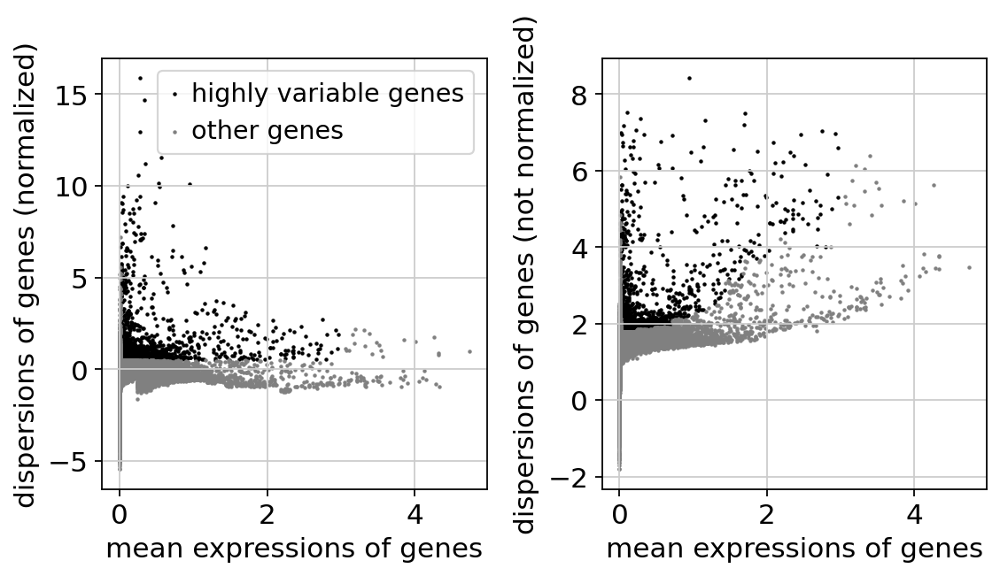

CPU times: user 684 ms, sys: 8 ms, total: 692 ms
Wall time: 688 ms


In [65]:
%%time
sc.pl.highly_variable_genes(adata)

In [66]:
adata_hvg = adata[:, adata.var['highly_variable']]

In [67]:
adata_hvg

View of AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5',

In [68]:
%%time
sc.pp.scale(adata_hvg, max_value=10)

/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:806: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
CPU times: user 7.69 s, sys: 45.3 s, total: 53 s
Wall time: 53 s


________

# ANNOTATION through LOGISTIC REGRESSION

In [71]:
# reading annotation of the 8-sample object, GEX + SoupX-denoised protein
annot_table = pd.read_csv(save_path + 'annotation_of_adata_hvg_BBKNN_GEX_and_SoupX_denoised_protein.csv', index_col=0)

In [72]:
np.unique(annot_table['prelim_annot'])

array(['B_cells', 'Class_Monocytes', 'Interm_Monocytes', 'MAIT_cells',
       'NKT_cells', 'NK_CD16_bright', 'NK_CD16_bright_activated',
       'NK_CD56_bright', 'NK_CD56_bright_activated',
       'Non-class_Monocytes', 'Plasma_cells', 'Precursor_cells',
       'T4_memory', 'T4_memory_activated', 'T4_naive',
       'T4_naive_activated', 'T8_memory', 'T8_memory_activated',
       'T8_naive', 'T8_naive_activated', 'cDC', 'gdT_cells'], dtype=object)

In [73]:
annot_table

,prelim_annot
index,
AAACCTGAGAATGTGT-1,Interm_Monocytes
AAACCTGAGACTAAGT-1,cDC
AAACCTGAGCCGCCTA-1,T8_naive
AAACCTGAGCGCCTCA-1,T8_memory
AAACCTGAGGATGTAT-1,T8_memory
...,...
TTTGTCATCATCGATG-1,Non-class_Monocytes
TTTGTCATCATCGCTC-1,NK_CD56_bright
TTTGTCATCCTTAATC-1,NK_CD16_bright


In [74]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_i

In [75]:
# object with previous 8 samples, annotated, GEX + SoupX-denoised protein
# by mistake - data in .raw.X is normalised, log tr and scaled, so take .raw.X
adata_sc_annotated = sc.read(save_path + 'adata_hvg_bbknn_by_sample_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein.h5ad')

In [76]:
adata_sc_annotated.obs['prelim_annot'] = annot_table.loc[adata_sc_annotated.obs.index,'prelim_annot']

... storing 'prelim_annot' as categorical


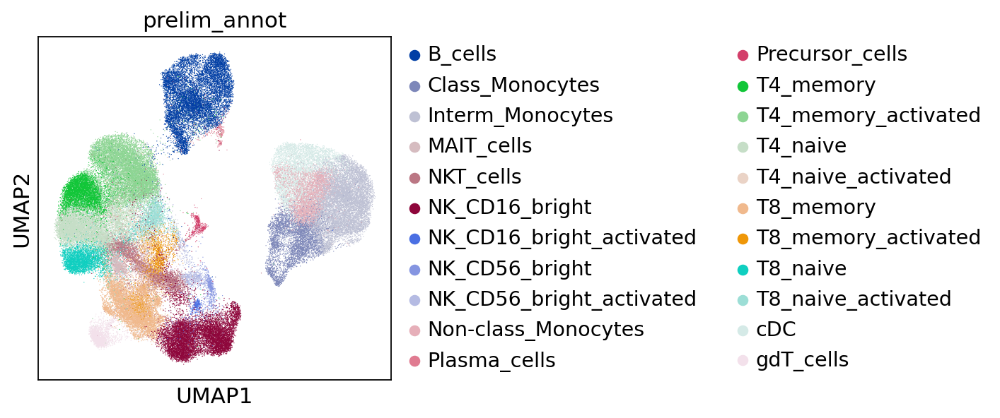

In [77]:
sc.pl.umap(adata_sc_annotated, color='prelim_annot')

In [78]:
np.unique(adata_sc_annotated.var['highly_variable'])

array([ True])

In [79]:
# these are HVGs
hvgs = adata_sc_annotated.var_names
len(hvgs)

1702

## Model 1 - trained on previous annotated GEX-only scRNA-seq object with the first 8 samples only

### Subsetting both datasets' copies to common genes only

I will train logreg on the subsetted data and tranfer the annotation onto the corresponding subsetted new data and then transfer that onto the full (with all genes) new dataset

In [80]:
# annotated object, normalised, log transformed and scaled in .raw.X
adata_train = anndata.AnnData(X = adata_sc_annotated.raw.X,
                              obs = adata_sc_annotated.obs,
                              var = adata_sc_annotated.raw.var)
# subsetting to HVG
adata_train = adata_train[:,hvgs].copy()

In [82]:
# normalised, log transformed object, scaled and HVG-subsetted object
adata_test = adata_hvg.copy()

In [83]:
adata_train.obs.columns

Index(['batch', 'bh_pval', 'cell_id', 'dataset', 'n_counts', 'n_genes',
       'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score',
       'stimulation', 'technique', 'is_doublet', 'donor_ID_temp', 'S_score',
       'G2M_score', 'phase', 'n_counts_protein', 'n_counts_protein_lognorm',
       'prelim_annot'],
      dtype='object')

In [84]:
# list of genes shared between blood and bone marrow data
# doing sorted on the overall list is VERY important for consistent ordering of the genes
common_genes = sorted(list(set(adata_train.var_names) & set(adata_test.var_names)))
print(len(common_genes),"genes are shared between annotated train and our joint data \n",
      len(set(adata_train.var_names)), 'genes in training data \n',
      len((set(adata_test.var_names))), 'genes in test joint data \n')

1584 genes are shared between annotated train and our joint data 
 1702 genes in training data 
 2734 genes in test joint data 



Going to copy a joint dataset with only common genes, but then transfer annotation from logreg onto the full dataset

In [85]:
adata_train_copy = adata_train[:,common_genes]

In [86]:
adata_train_copy.var_names

Index(['A2M-AS1', 'ABAT', 'ABCA2', 'ABCA5', 'ABCA7', 'ABCB1', 'ABCD2',
       'ABHD15', 'AC002117.1', 'AC005037.3',
       ...
       'ZNF845', 'ZNF862', 'ZNF880', 'ZNF92', 'ZSCAN12', 'ZSCAN18', 'ZSCAN26',
       'anti-Tau-Phospho', 'anti-c-Met', 'humanMac-2(Galectin-3)'],
      dtype='object', name='index', length=1584)

In [87]:
adata_test_copy = adata_test[:,common_genes]
adata_test_copy.var_names

Index(['A2M-AS1', 'ABAT', 'ABCA2', 'ABCA5', 'ABCA7', 'ABCB1', 'ABCD2',
       'ABHD15', 'AC002117.1', 'AC005037.3',
       ...
       'ZNF845', 'ZNF862', 'ZNF880', 'ZNF92', 'ZSCAN12', 'ZSCAN18', 'ZSCAN26',
       'anti-Tau-Phospho', 'anti-c-Met', 'humanMac-2(Galectin-3)'],
      dtype='object', length=1584)

In [88]:
# checking gene correspondence - important!
list(adata_test_copy.var_names) == list(adata_train_copy.var_names)

True

In [89]:
np.unique(adata_train_copy.obs['prelim_annot'],return_counts=True)

(array(['B_cells', 'Class_Monocytes', 'Interm_Monocytes', 'MAIT_cells',
        'NKT_cells', 'NK_CD16_bright', 'NK_CD16_bright_activated',
        'NK_CD56_bright', 'NK_CD56_bright_activated',
        'Non-class_Monocytes', 'Plasma_cells', 'Precursor_cells',
        'T4_memory', 'T4_memory_activated', 'T4_naive',
        'T4_naive_activated', 'T8_memory', 'T8_memory_activated',
        'T8_naive', 'T8_naive_activated', 'cDC', 'gdT_cells'], dtype=object),
 array([ 9923,  4767, 10184,  1231,  4094,  9610,   356,   623,   759,
         3483,   210,   433,  5644, 10214,  8618,   184,  7907,  1618,
         3531,  2187,  5097,  2076]))

## Training a logistic regression model on previously annotated 10X data from Roser+Suryawanshi

In [90]:
adata_train_copy.obs['prelim_annot'].head()

index
AAACCTGAGAATGTGT-1    Interm_Monocytes
AAACCTGAGACTAAGT-1                 cDC
AAACCTGAGCCGCCTA-1            T8_naive
AAACCTGAGCGCCTCA-1           T8_memory
AAACCTGAGGATGTAT-1           T8_memory
Name: prelim_annot, dtype: category
Categories (22, object): [B_cells, Class_Monocytes, Interm_Monocytes, MAIT_cells, ..., T8_naive, T8_naive_activated, cDC, gdT_cells]

In [91]:
celltypes_train = adata_train_copy.obs['prelim_annot']

In [92]:
adata_train_copy.X.shape

(92749, 1584)

Using ONLY COMMON GENES

In [93]:
%time
# training a logistic regression model on scRNA-seq data
# takes 4-5 hours?
# started ~ at 12:23
logisticRegr_sc = LogisticRegression(max_iter = 10000, n_jobs = -1, random_state = 0, C=0.2)
logisticRegr_sc.fit(adata_train_copy.X, celltypes_train)

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 5.25 µs


/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:1544: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 16.
  " = {}.".format(effective_n_jobs(self.n_jobs)))


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='warn', n_jobs=-1, penalty='l2', random_state=0,
                   solver='warn', tol=0.0001, verbose=0, warm_start=False)

In [94]:
# Saving model trained on scRNA-seq
# already done
# logreg_sc_hvg.pkl was for the object in which ccgs are not removed
pkl_filename = "logreg_sc_from_8-sample_GEX_and_SoupX_denoised_protein.pkl"  
with open(pkl_filename, 'wb') as file:  
    pickle.dump(logisticRegr_sc, file)

In [21]:
# Load model (scRNA-seq) from file
pkl_filename = "logreg_sc_from_8-sample_GEX_and_SoupX_denoised_protein.pkl"
with open(pkl_filename, 'rb') as file:  
    logisticRegr_sc = pickle.load(file)

In [95]:
adata_train_copy

View of AnnData object with n_obs × n_vars = 92749 × 1584
    obs: 'batch', 'bh_pval', 'cell_id', 'dataset', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'stimulation', 'technique', 'is_doublet', 'donor_ID_temp', 'S_score', 'G2M_score', 'phase', 'n_counts_protein', 'n_counts_protein_lognorm', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'

In [96]:
adata_test_copy

View of AnnData object with n_obs × n_vars = 163320 × 1584
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5',

In [97]:
logisticRegr_sc

LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='warn', n_jobs=-1, penalty='l2', random_state=0,
                   solver='warn', tol=0.0001, verbose=0, warm_start=False)

In [98]:
%%time
predictions = logisticRegr_sc.predict(adata_test_copy.X)
adata_test_copy.obs['celltype_predictions'] = predictions

Trying to set attribute `.obs` of view, copying.


CPU times: user 26 s, sys: 1min 22s, total: 1min 48s
Wall time: 1min 29s


In [99]:
%%time
# probabilities
probabilities = logisticRegr_sc.predict_proba(adata_test_copy.X)
probs_adata = []
for i,clus in enumerate(adata_test_copy.obs['celltype_predictions']):
    probs_adata.append(probabilities[i,logisticRegr_sc.classes_==clus][0])


CPU times: user 3.63 s, sys: 17.7 s, total: 21.3 s
Wall time: 17.9 s


In [100]:
list(adata_test_copy.obs.index) == list(adata.obs.index)

True

In [101]:
adata.obs['probabilities'] = probs_adata

In [102]:
adata.obs['celltype_predictions'] = adata_test_copy.obs['celltype_predictions']

In [103]:
adata.obs.loc[:,['celltype_predictions','probabilities']].to_csv(save_path+'adata_preproc_regressed_obs_table_all_samples.csv')

In [104]:
adata

AnnData object with n_obs × n_vars = 163320 × 22043
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_

_________________

### adding protein count stats

In [111]:
adata_raw = sc.read(save_path+'adata_raw_filtered.h5ad')

In [112]:
adata_raw_protein = adata_raw[:,adata_raw.var['feature_types-0'] == 'Antibody Capture'].copy()

In [113]:
adata_raw_protein.obs['n_counts_protein'] = adata_raw_protein.X.sum(axis=1).A1

In [114]:
adata_hvg.obs['n_counts_protein'] = adata_raw_protein.obs.loc[adata_hvg.obs.index, 'n_counts_protein']

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:961: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [115]:
adata_lognorm_protein = adata_raw_protein.copy()
sc.pp.normalize_per_cell(adata_lognorm_protein, counts_per_cell_after=1e4)
sc.pp.log1p(adata_lognorm_protein)

adata_lognorm_protein.obs['n_counts_protein_lognorm'] = adata_lognorm_protein.X.sum(axis=1).A1

normalizing by total count per cell
    finished (0:00:44): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [116]:
adata_hvg.obs['n_counts_protein_lognorm'] = adata_lognorm_protein.obs.loc[adata_hvg.obs.index, 'n_counts_protein_lognorm']

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:961: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


________

## PCA

In [105]:
%%time
sc.tl.pca(adata_hvg, svd_solver='arpack', n_comps=50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:02:08)
CPU times: user 3min 37s, sys: 4min 46s, total: 8min 24s
Wall time: 2min 8s


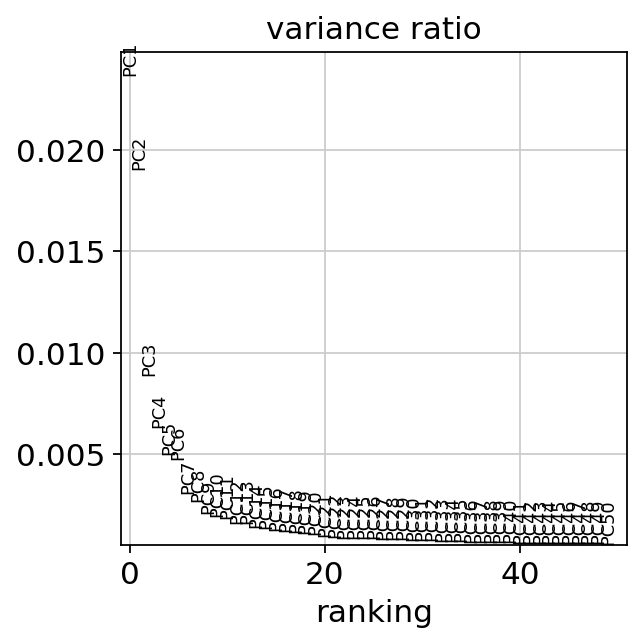

In [106]:
sc.pl.pca_variance_ratio(adata_hvg, n_pcs=50)

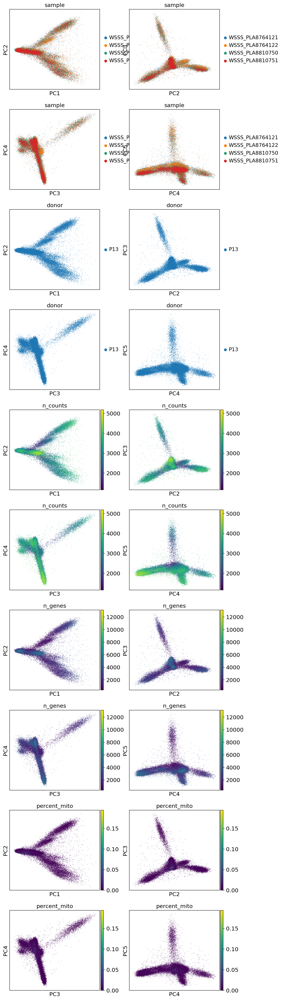

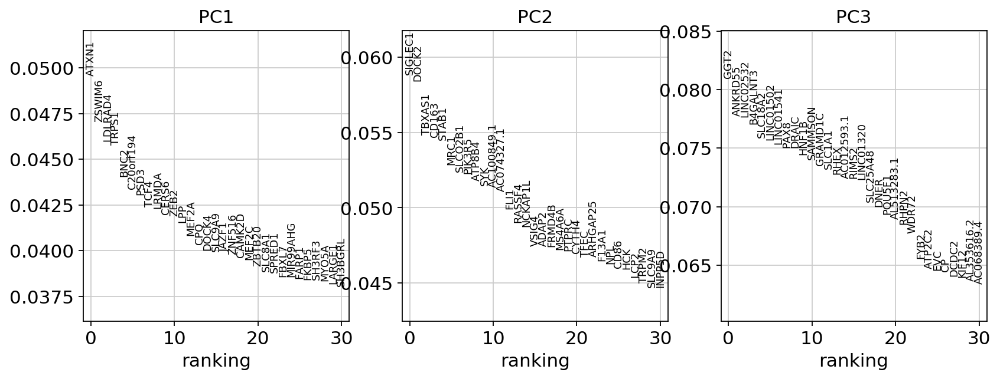

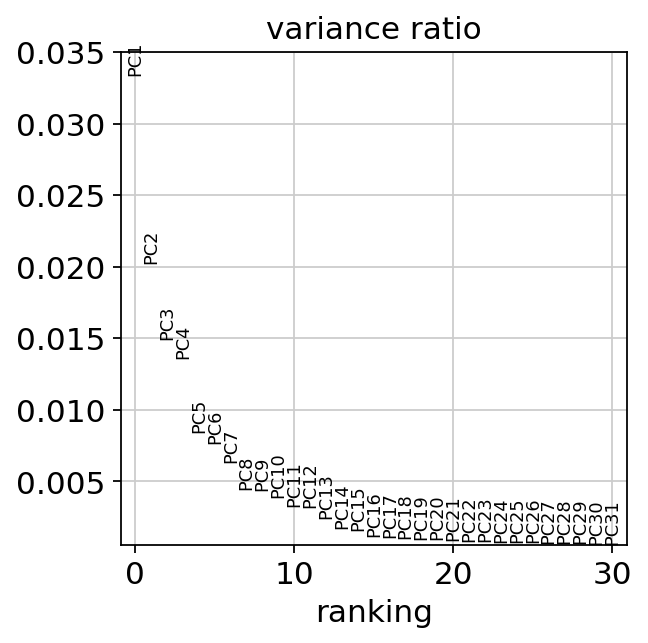

In [56]:
sc.pl.pca_overview(adata_hvg, color = ['sample', 'donor', 'n_counts', 'n_genes', 
                                    'percent_mito'], components = ['1,2', '2,3', '3,4', '4,5'], ncols = 2)

## OR

### Harmony

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:03:03)


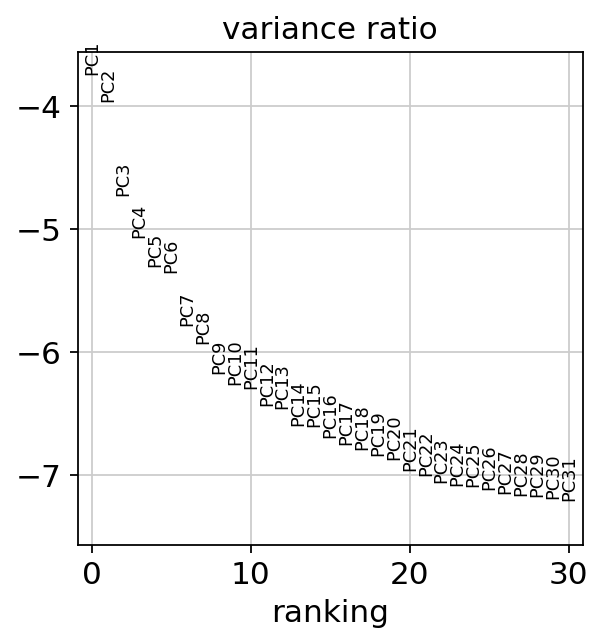

CPU times: user 3min 32s, sys: 5min 56s, total: 9min 29s
Wall time: 3min 4s


In [148]:
%%time
# trying out harmony here
# Check PCA again - needed for harmony - and extract PCA matrix and batch array
sc.tl.pca(adata_hvg)
n_pcs = 20
sc.pl.pca_variance_ratio(adata_hvg, log=True, save=False)
pca = adata_hvg.obsm['X_pca'][:, 0:n_pcs]
batch = adata_hvg.obs['sample']

In [149]:
# Batch-correct the PCA using HARMONY method
%load_ext rpy2.ipython

In [150]:
%%time
%%R -i pca -i batch -o hem

library(harmony)
library(magrittr)

hem <- HarmonyMatrix(pca, batch, theta=1, do_pca=FALSE)
hem = data.frame(hem)


R[write to console]: Loading required package: Rcpp

R[write to console]: Harmony 1/10

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[

CPU times: user 38min 51s, sys: 24min 37s, total: 1h 3min 29s
Wall time: 34min 5s


In [151]:
# Add harmony values to the anndata object
adata_hvg.obsm['X_pca'] = hem.values

_______

### Neighbourhood graph & UMAP

__________________________________________________________________________________________________________________________________________________________________

In [152]:
%%time
sc.pp.neighbors(adata_hvg, n_neighbors=10, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20


/opt/conda/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../opt/conda/lib/python3.7/site-packages/umap/nndes

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:45)
CPU times: user 38 s, sys: 7.53 s, total: 45.6 s
Wall time: 45.5 s


### OR

BBKNN by donor


In [130]:
%%time
bbknn.bbknn(adata_hvg, batch_key='sample')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:01:08)
CPU times: user 55.4 s, sys: 13.1 s, total: 1min 8s
Wall time: 1min 8s


/opt/conda/lib/python3.7/site-packages/bbknn/__init__.py:289: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = bbknn_out[0]
/opt/conda/lib/python3.7/site-packages/bbknn/__init__.py:290: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = bbknn_out[1]


__________________________________________________________________________________________________________________________________________________________________

In [153]:
%%time
sc.tl.umap(adata_hvg, random_state=0)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:08)
CPU times: user 5min 14s, sys: 2min 47s, total: 8min 2s
Wall time: 3min 8s


# Plotting

In [132]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

In [110]:
markers = ['CD4','CD3G', 'FOXJ1', 'IL2R', 'TRDV2', 'CD8', # T cells
                             'CD19', 'MS4A1', # B cells
                              'CD27', 'CD38', 'JCHAIN', # Plasma B cells
                             'NCAM1', 'FCGR3A', # NK celss
                             'HBB', # Erythrocytes
                             'FCGR3B', # Neutrophils
                             'CD14', 'S100A12', # Monocytes
                             'FLT3', # Dendritic cells
                             'IRF4', 'CLEC9A', # cDC1
                             'CD1C', # cDC2
                             'TNFRSF21', # pDC and IRF4
                             'CD34', # Precursors
                             'PPBP', 'TUBB1', 'PF4', # Platelets
                             'MI67', # cycling
                            ]

### No batch correction

20 PCs

... storing 'phase' as categorical


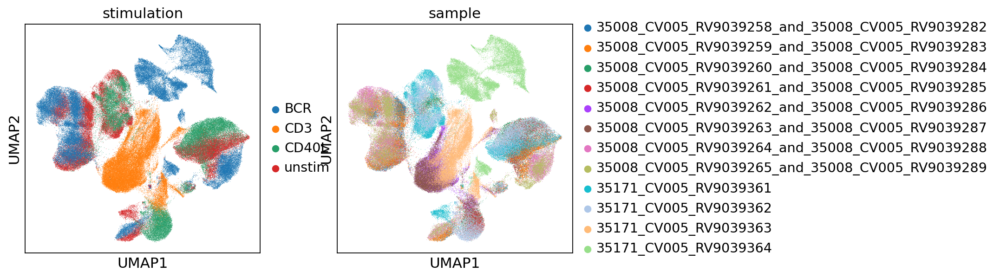

In [117]:
sc.pl.umap(adata_hvg, color=['stimulation','sample'])

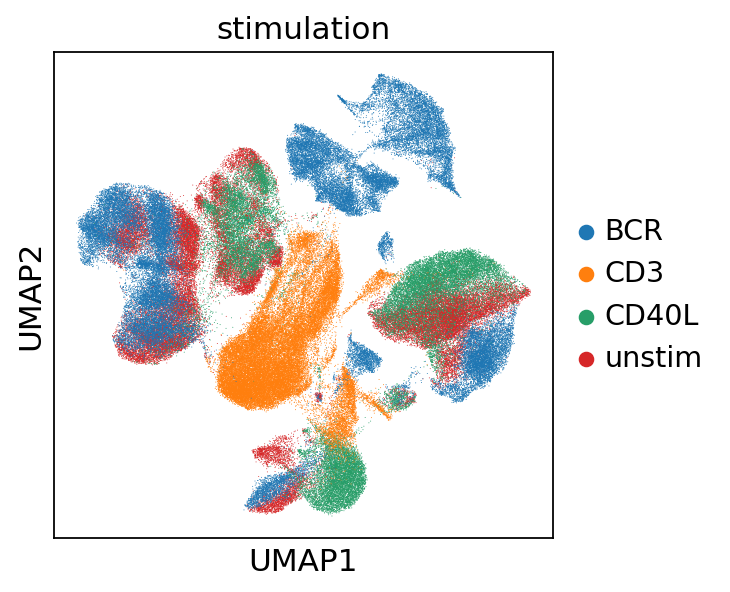

In [118]:
sc.pl.umap(adata_hvg, color=['stimulation'])

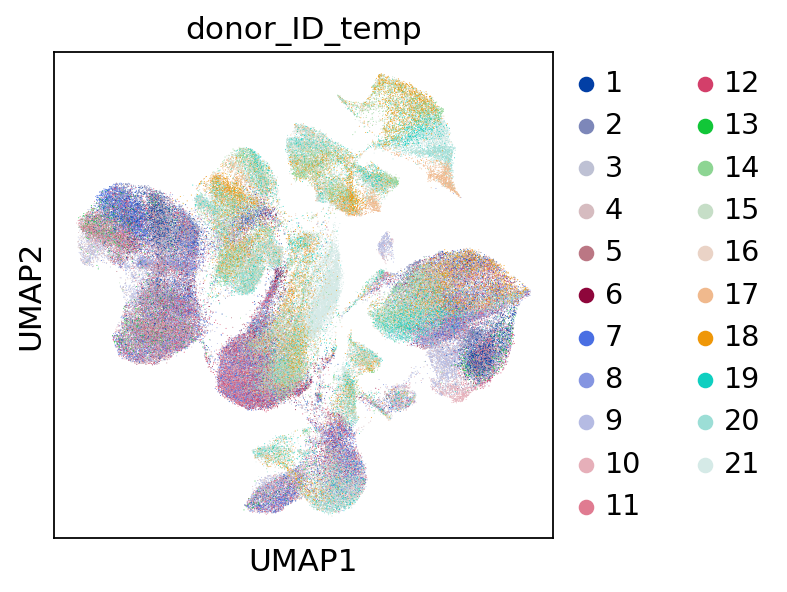

In [119]:
sc.pl.umap(adata_hvg, color=['donor_ID_temp'])

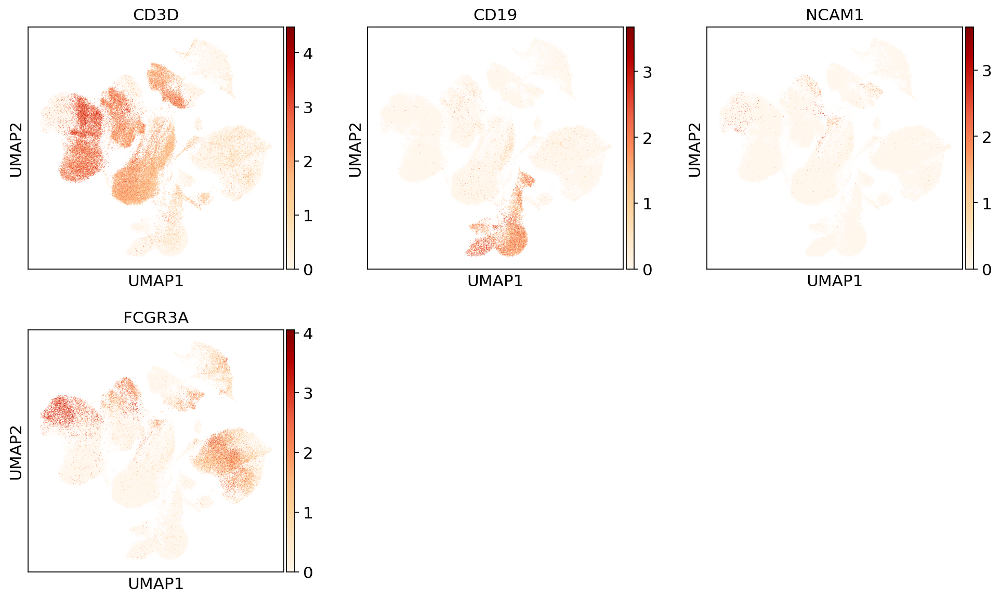

In [120]:
sc.pl.umap(adata_hvg, color=['CD3D', # T cells
                             'CD19', # B cells
                             # NK markers
                             'NCAM1', # CD56
                             'FCGR3A', # CD16
                            ], ncols=3, use_raw=True, cmap='OrRd')

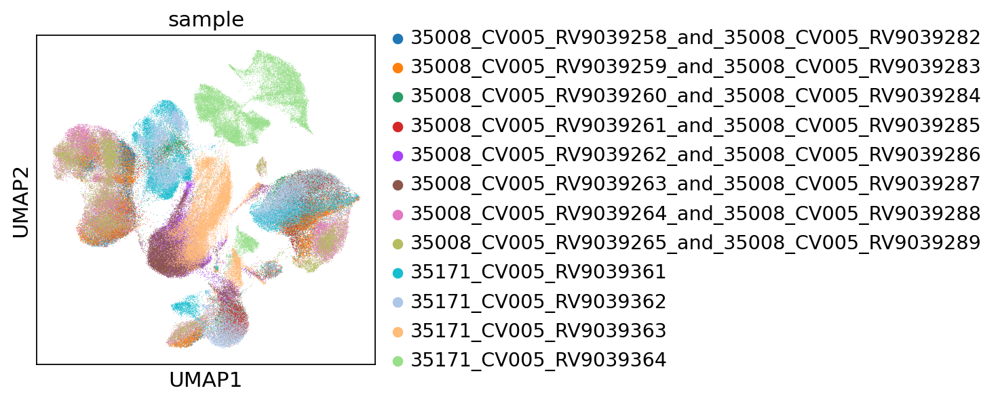

In [121]:
sc.pl.umap(adata_hvg, color=['sample'])

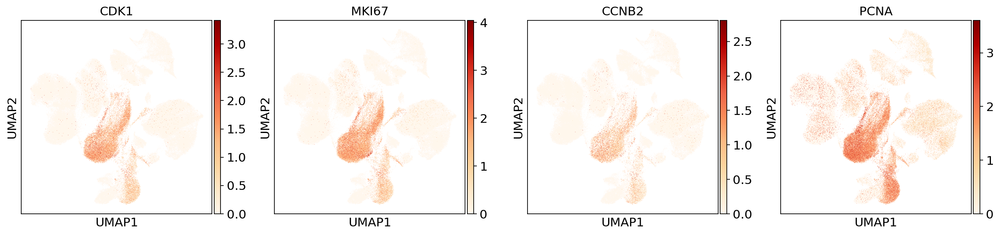

In [122]:
sc.pl.umap(adata_hvg, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [123]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

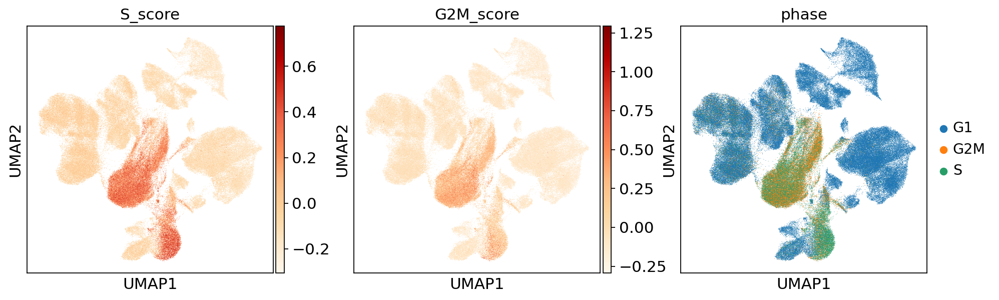

In [124]:
sc.pl.umap(adata_hvg, color=['S_score','G2M_score','phase'], cmap='OrRd')

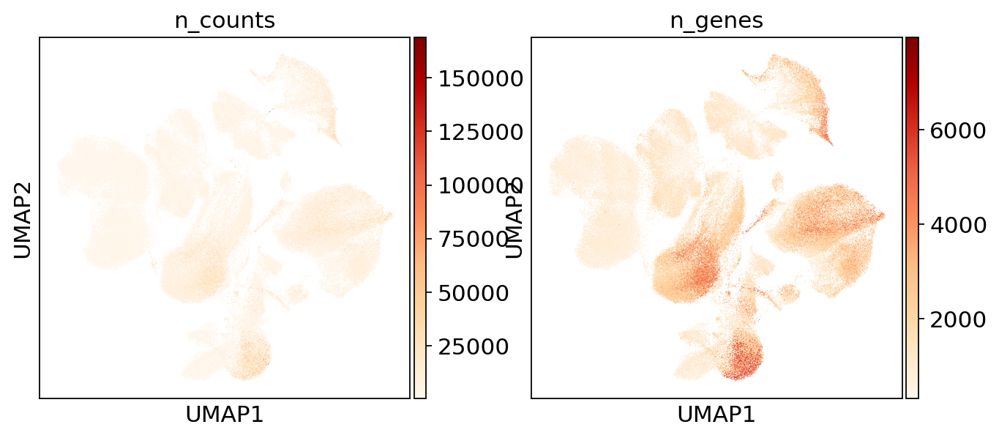

In [125]:
sc.pl.umap(adata_hvg, color=['n_counts',
                             'n_genes'], cmap='OrRd')

In [11]:
pred_table = pd.read_csv(save_path+'adata_preproc_regressed_obs_table_all_samples.csv', index_col=0)

# adding to adata_hvg
adata_hvg.obs['celltype_predictions'] = pred_table.loc[adata_hvg.obs.index,'celltype_predictions']
adata_hvg.obs['probabilities'] = pred_table.loc[adata_hvg.obs.index,'probabilities']

In [12]:
np.unique(pred_table['celltype_predictions'])

array(['B_cells', 'Class_Monocytes', 'Interm_Monocytes', 'MAIT_cells',
       'NKT_cells', 'NK_CD16_bright', 'NK_CD16_bright_activated',
       'NK_CD56_bright', 'NK_CD56_bright_activated',
       'Non-class_Monocytes', 'Plasma_cells', 'Precursor_cells',
       'T4_memory', 'T4_memory_activated', 'T4_naive',
       'T4_naive_activated', 'T8_memory', 'T8_memory_activated',
       'T8_naive', 'T8_naive_activated', 'cDC', 'gdT_cells'], dtype=object)

... storing 'celltype_predictions' as categorical


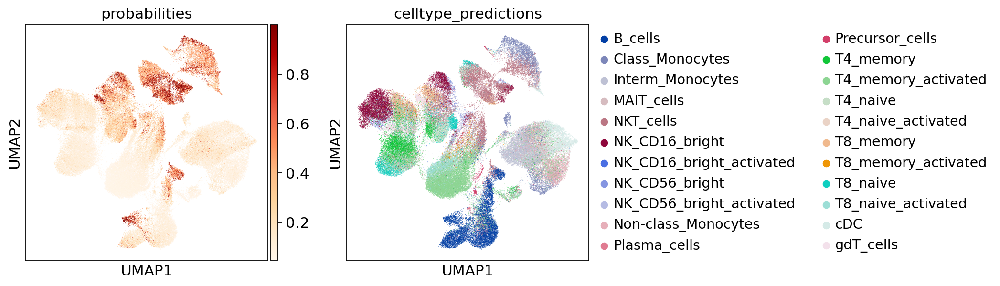

In [13]:
sc.pl.umap(adata_hvg, color=['probabilities',
                             'celltype_predictions'], cmap='OrRd')

In [24]:
# are any proteins in HVGs?
adata_prot = adata_hvg[:, adata_hvg.var['feature_types-0'] == 'Antibody Capture'].copy()
adata_prot

AnnData object with n_obs × n_vars = 163320 × 141
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fea

Index(['A1BG', 'A1BG-AS1', 'A2M', 'A2M-AS1', 'A2ML1', 'A4GALT', 'A4GNT',
       'AAAS', 'AACS', 'AADAT',
       ...
       'ZZEF1', 'ZZZ3', 'anti-Tau-Phospho', 'anti-c-Met', 'bP-21264C1.2',
       'bP-2189O9.3', 'humanCD207', 'humanMac-2(Galectin-3)',
       'mouse/ratCD278(ICOS)', 'mouseintegrinB7'],
      dtype='object', length=22144)

In [127]:
adata_hvg.write(save_path+'adata_hvg_no_batch_correction_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

In [10]:
adata_hvg = sc.read(save_path+'adata_hvg_no_batch_correction_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

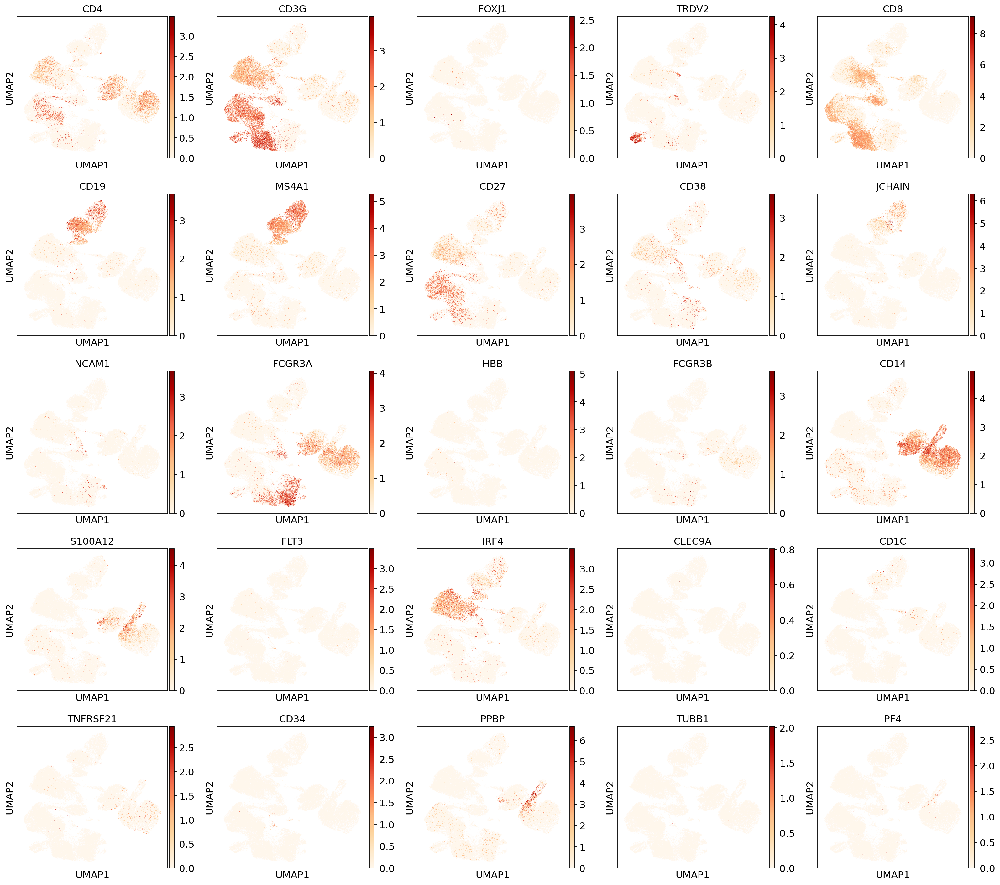

In [76]:
# old
sc.pl.umap(adata_hvg, color=[elem for elem in markers if elem in list(adata_hvg.raw.var.index)],
           use_raw=True, cmap='OrRd',
          ncols=5)

In [128]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

In [129]:
np.unique(adata_hvg.obs['n_counts_protein'])

array([17., 37., 43., ..., nan, nan, nan], dtype=float32)

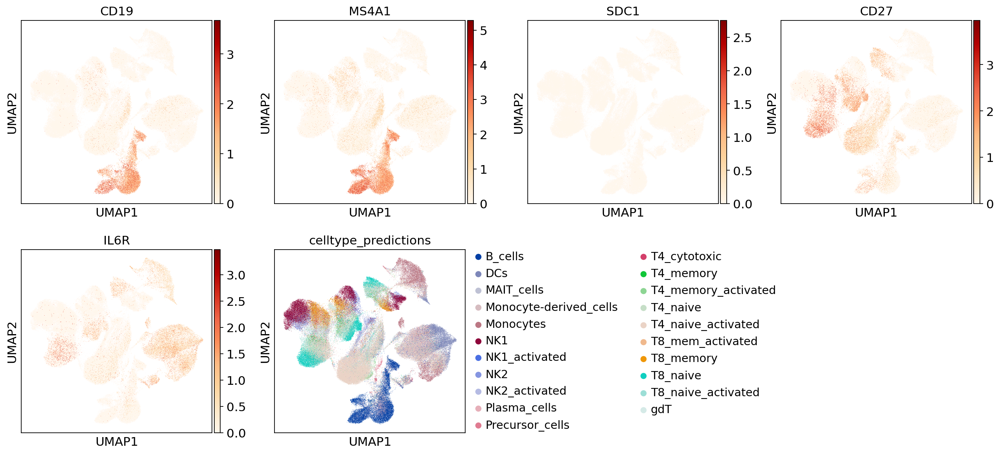

In [147]:
sc.pl.umap(adata_hvg, color=['CD19', # B cells
                                     'MS4A1', # CD20, B cells
                                     'SDC1', # CD138, Plasma cells
                                     #'CDW78', # CD78
                                     'CD27', 'IL6R', # Plasma cells
                            'celltype_predictions',
                            ], 
           cmap='OrRd'
          )

## BBKNN by ```sample```

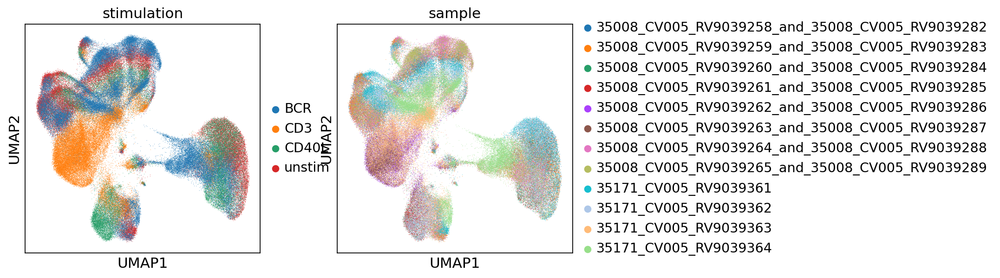

In [133]:
sc.pl.umap(adata_hvg, color=['stimulation','sample'])

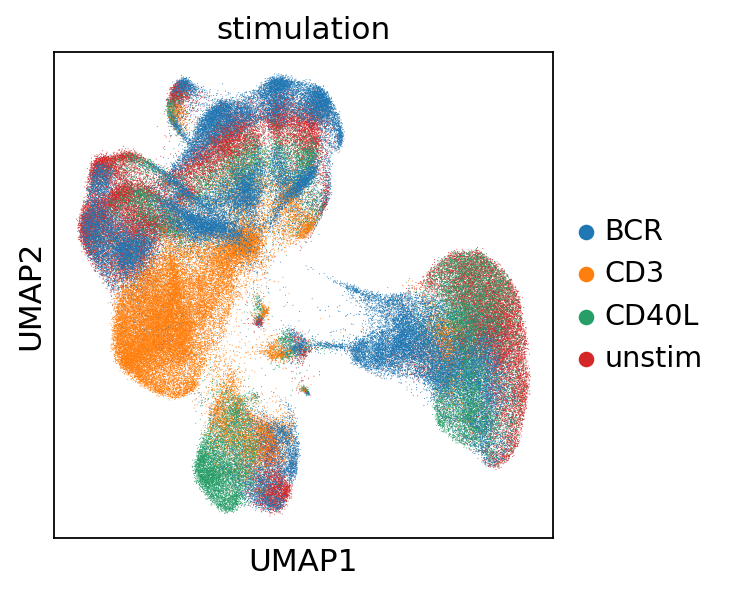

In [134]:
sc.pl.umap(adata_hvg, color=['stimulation'])

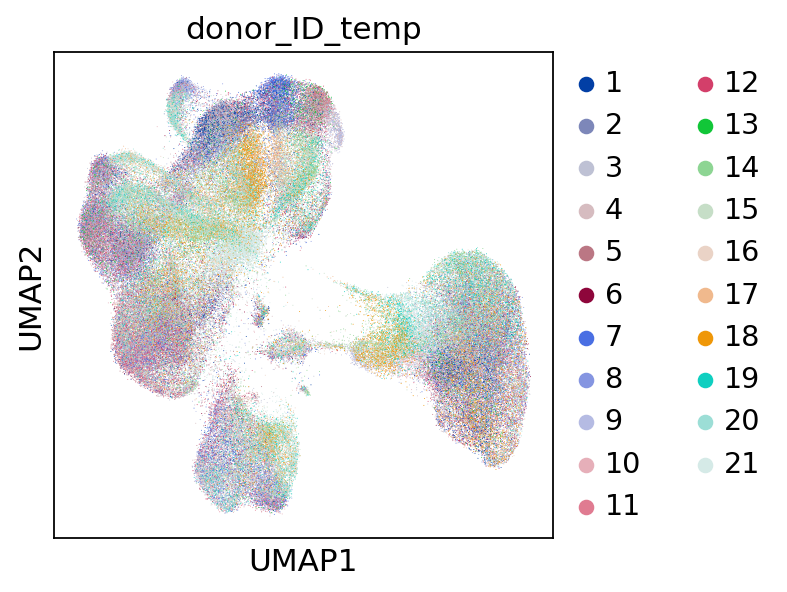

In [135]:
sc.pl.umap(adata_hvg, color=['donor_ID_temp'])

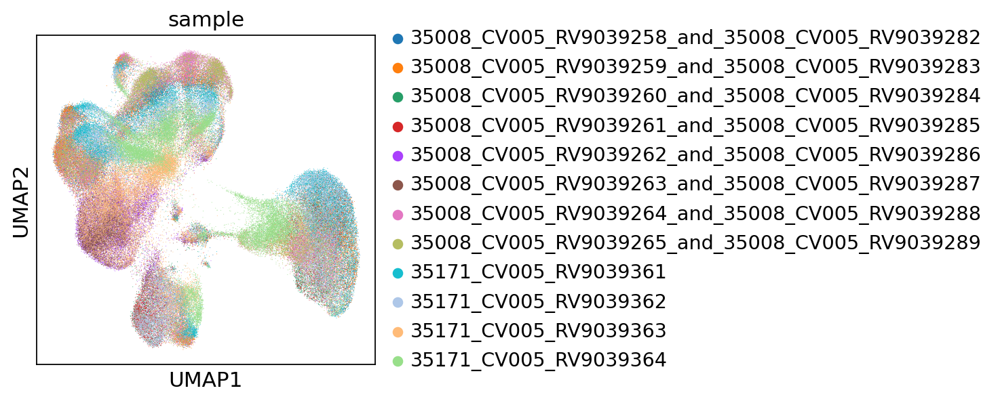

In [136]:
sc.pl.umap(adata_hvg, color=['sample'])

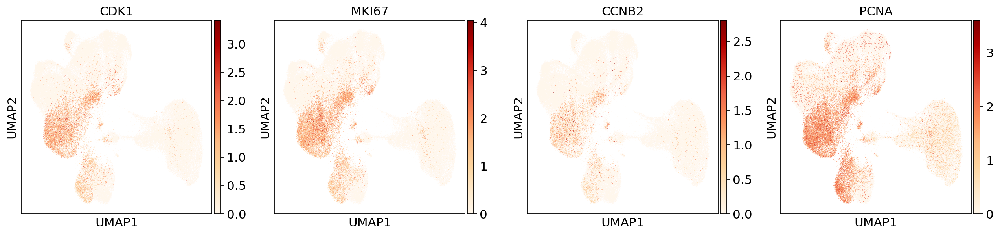

In [137]:
sc.pl.umap(adata_hvg, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [138]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

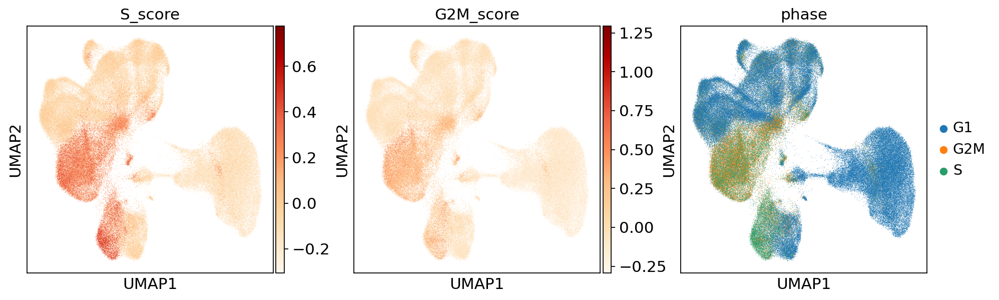

In [139]:
sc.pl.umap(adata_hvg, color=['S_score','G2M_score','phase'], cmap='OrRd')

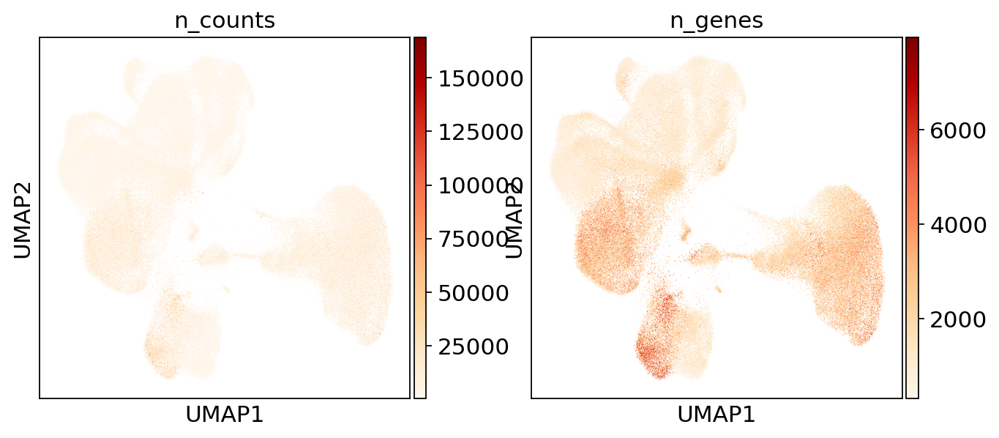

In [140]:
sc.pl.umap(adata_hvg, color=['n_counts',
                             'n_genes'], cmap='OrRd')

... storing 'celltype_predictions' as categorical


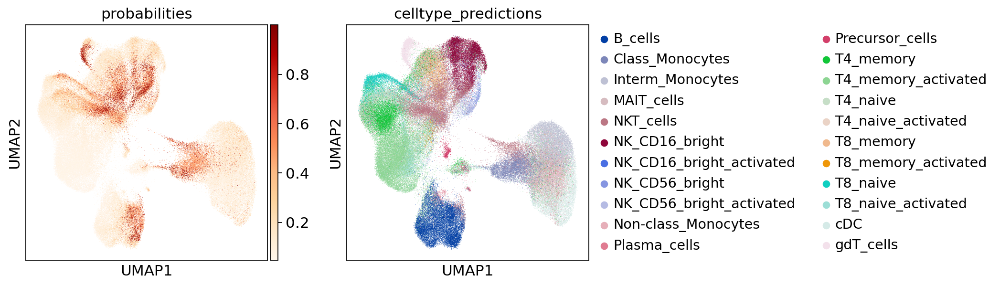

In [30]:
sc.pl.umap(adata_hvg, color=['probabilities',
                             'celltype_predictions'], cmap='OrRd')

In [28]:
pred_table = pd.read_csv(save_path+'adata_preproc_regressed_obs_table_all_samples.csv', index_col=0)

# adding to adata_hvg
adata_hvg.obs['celltype_predictions'] = pred_table.loc[adata_hvg.obs.index,'celltype_predictions']
adata_hvg.obs['probabilities'] = pred_table.loc[adata_hvg.obs.index,'probabilities']

In [29]:
np.unique(pred_table['celltype_predictions'])

array(['B_cells', 'Class_Monocytes', 'Interm_Monocytes', 'MAIT_cells',
       'NKT_cells', 'NK_CD16_bright', 'NK_CD16_bright_activated',
       'NK_CD56_bright', 'NK_CD56_bright_activated',
       'Non-class_Monocytes', 'Plasma_cells', 'Precursor_cells',
       'T4_memory', 'T4_memory_activated', 'T4_naive',
       'T4_naive_activated', 'T8_memory', 'T8_memory_activated',
       'T8_naive', 'T8_naive_activated', 'cDC', 'gdT_cells'], dtype=object)

In [31]:
adata_hvg.write(save_path+'adata_hvg_bbknn_by_sample_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

In [6]:
adata_hvg = sc.read(save_path+'adata_hvg_bbknn_by_sample_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

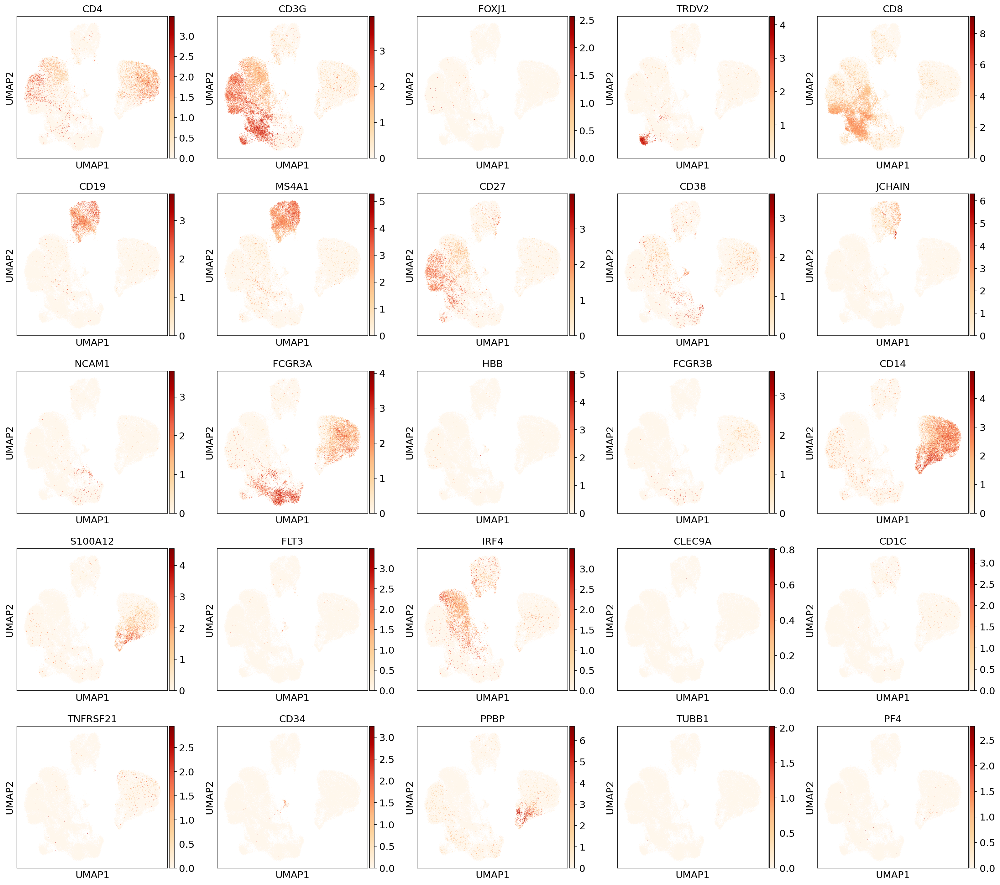

In [89]:
# old
sc.pl.umap(adata_hvg, color=[elem for elem in markers if elem in list(adata_hvg.raw.var.index)],
           use_raw=True, cmap='OrRd',
          ncols=5)

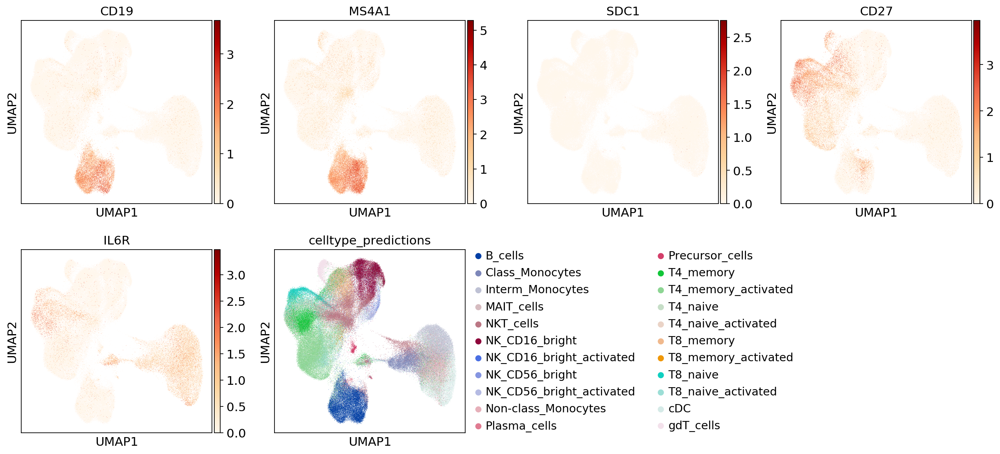

In [7]:
sc.pl.umap(adata_hvg, color=['CD19', # B cells
                                     'MS4A1', # CD20, B cells
                                     'SDC1', # CD138, Plasma cells
                                     #'CDW78', # CD78
                                     'CD27', 'IL6R', # Plasma cells
                            'celltype_predictions',
                            ], 
           cmap='OrRd'
          )

### Harmony by `sample`, theta=1

20 PCs

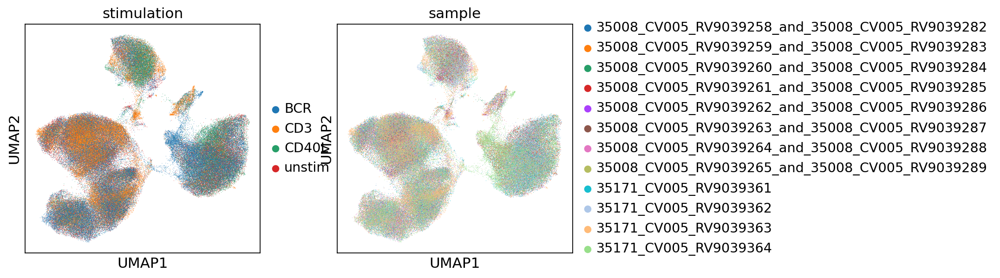

In [154]:
sc.pl.umap(adata_hvg, color=['stimulation','sample'])

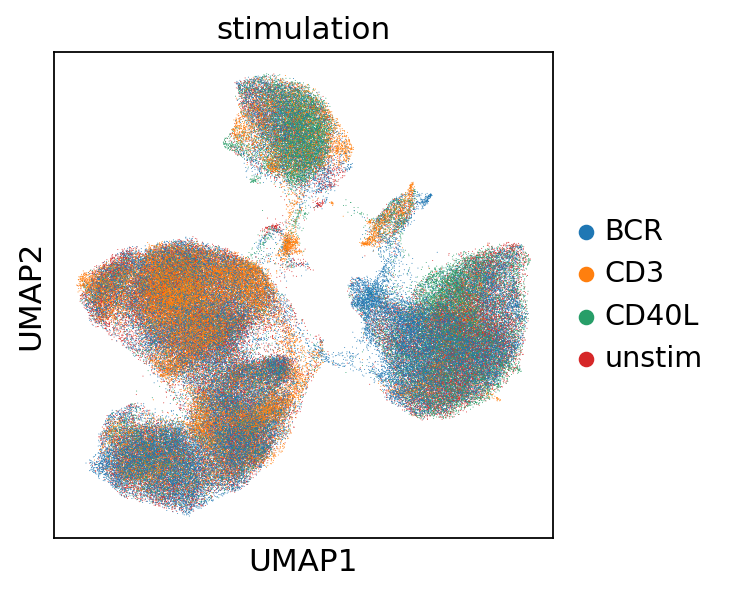

In [155]:
sc.pl.umap(adata_hvg, color=['stimulation'])

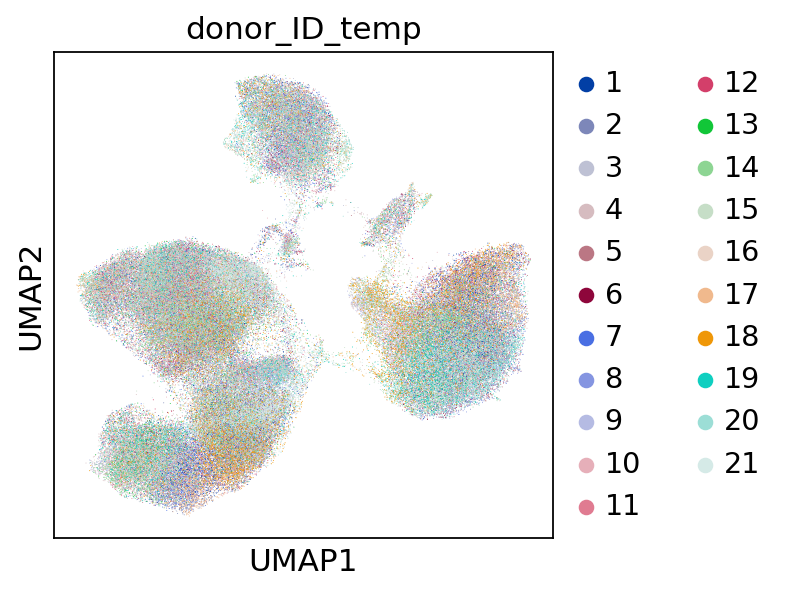

In [156]:
sc.pl.umap(adata_hvg, color=['donor_ID_temp'])

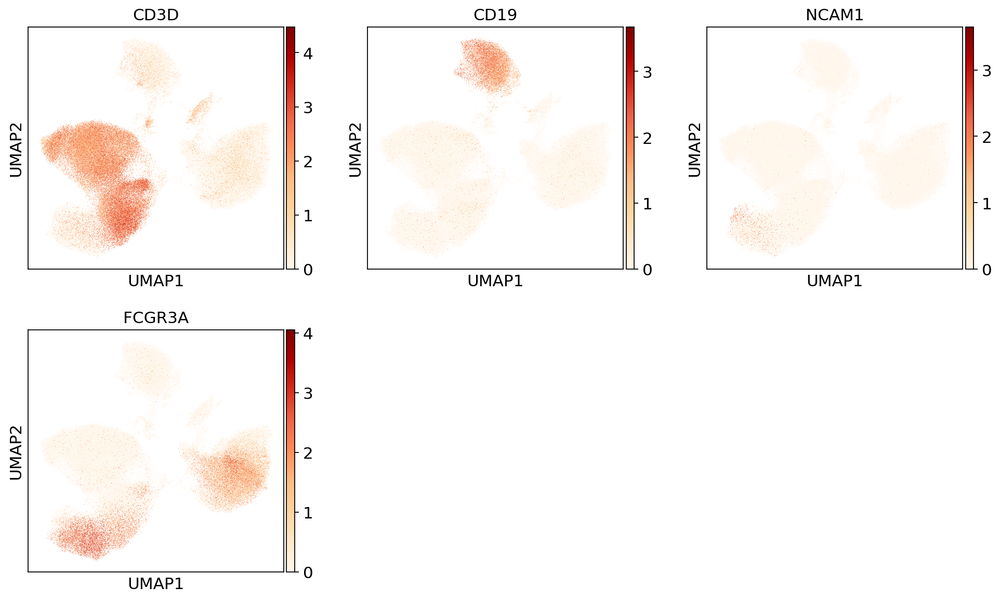

In [157]:
sc.pl.umap(adata_hvg, color=['CD3D', # T cells
                             'CD19', # B cells
                             # NK markers
                             'NCAM1', # CD56
                             'FCGR3A', # CD16
                            ], ncols=3, use_raw=True, cmap='OrRd')

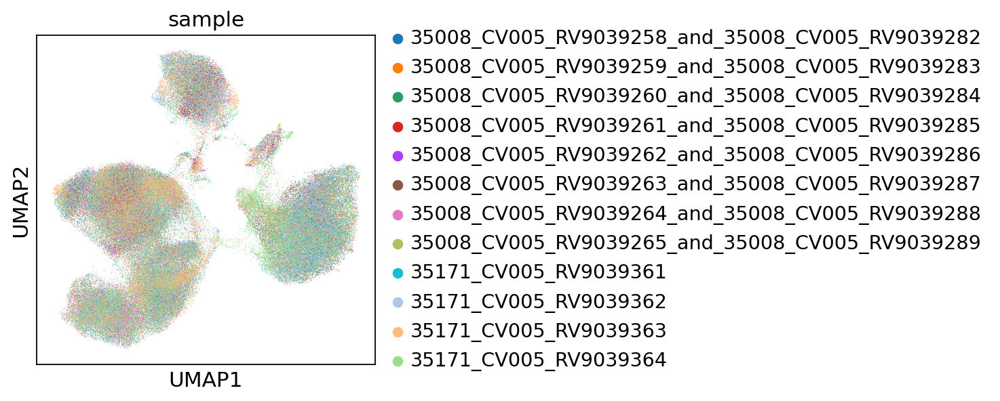

In [158]:
sc.pl.umap(adata_hvg, color=['sample'])

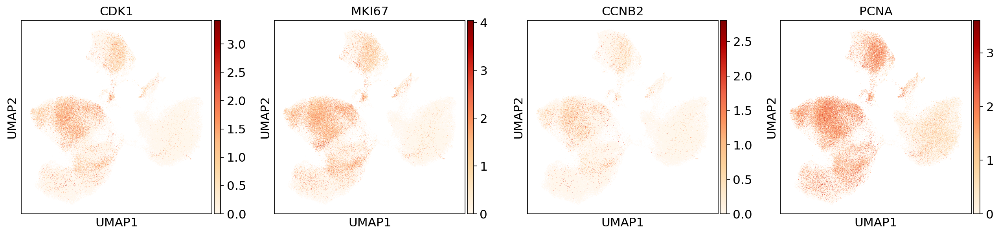

In [159]:
sc.pl.umap(adata_hvg, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [160]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

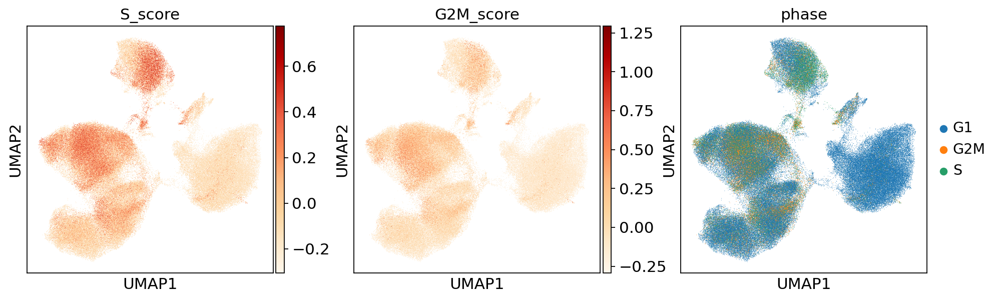

In [161]:
sc.pl.umap(adata_hvg, color=['S_score','G2M_score','phase'], cmap='OrRd')

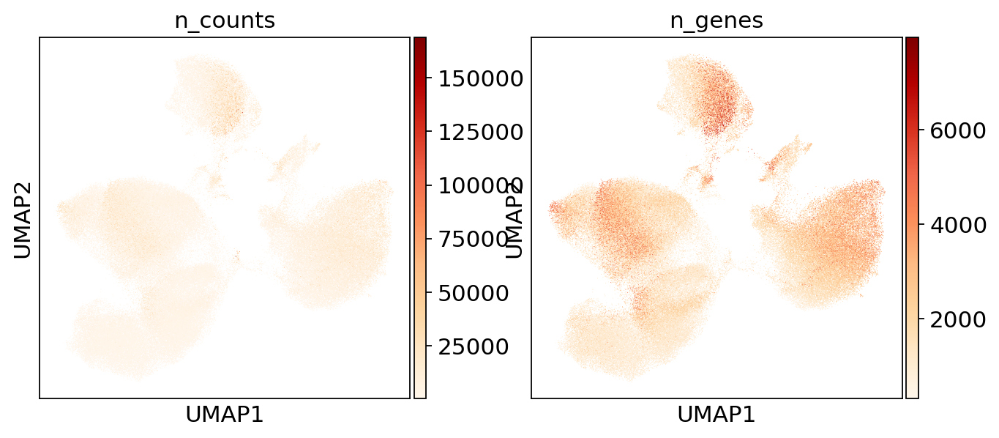

In [162]:
sc.pl.umap(adata_hvg, color=['n_counts',
                             'n_genes'], cmap='OrRd')

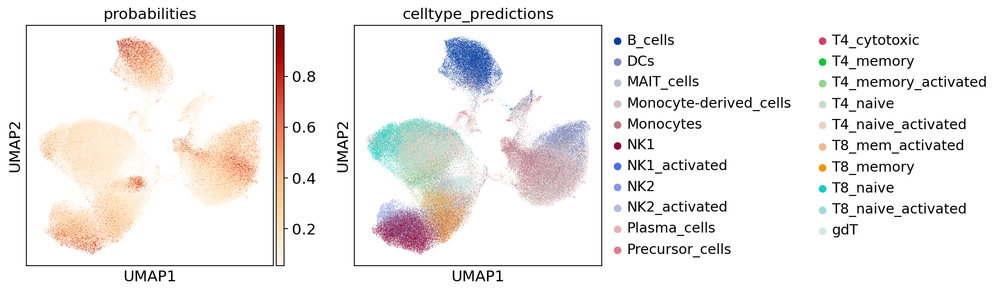

In [163]:
sc.pl.umap(adata_hvg, color=['probabilities',
                             'celltype_predictions'], cmap='OrRd')

In [164]:
adata_hvg.write(save_path+'adata_hvg_harmony_by_sample_theta_1_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

In [6]:
adata_hvg = sc.read(save_path+'adata_hvg_harmony_by_sample_theta_1_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples.h5ad')

In [7]:
# old
#sc.pl.umap(adata_hvg, color=[elem for elem in markers if elem in list(adata_hvg.raw.var.index)],
#           use_raw=True, cmap='OrRd',
#          ncols=5)

In [8]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

In [8]:
# after reading the BBKNN object
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

In [9]:
np.unique(adata_hvg.obs['n_counts_protein'])

array([17., 37., 43., ..., nan, nan, nan], dtype=float32)

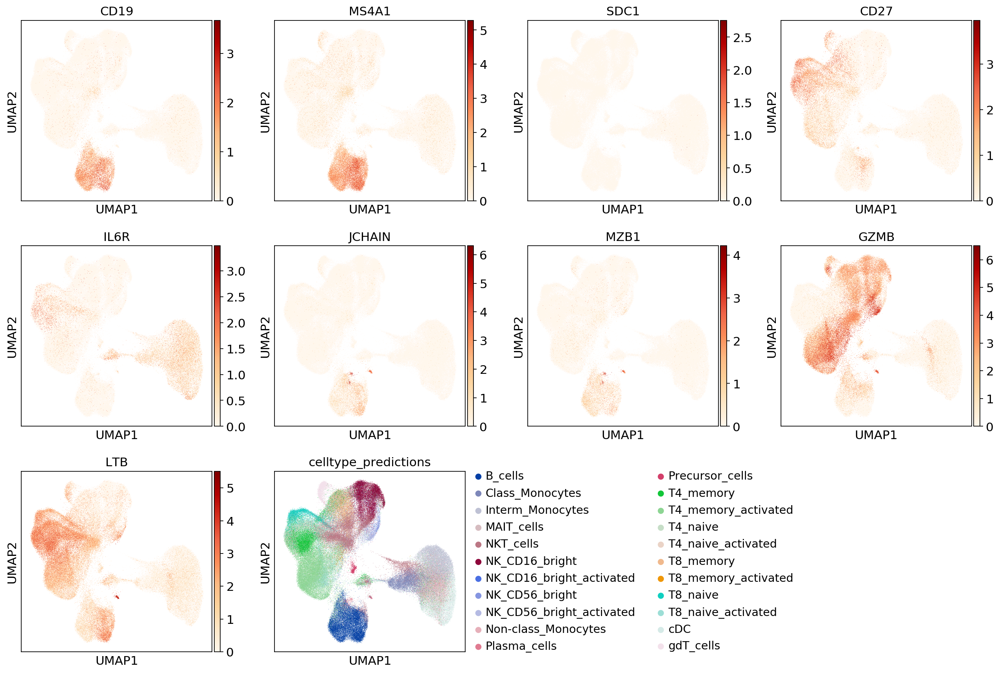

In [10]:
sc.pl.umap(adata_hvg, color=['CD19', # B cells
                                     'MS4A1', # CD20, B cells
                                     'SDC1', # CD138, Plasma cells
                                     #'CDW78', # CD78
                                     'CD27', 'IL6R', # Plasma cells
                             'JCHAIN', 'MZB1', # Plasma cells
                             'GZMB', 'LTB', # expr in pDC but not Plasma cells
                            'celltype_predictions',
                            ], 
           cmap='OrRd'
          )

### Unbiased clustering

In [11]:
%%time
# 19 was the previous object
sc.tl.louvain(adata_hvg, resolution=2.0)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 19 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:02:07)
CPU times: user 2min 5s, sys: 2.95 s, total: 2min 8s
Wall time: 2min 8s


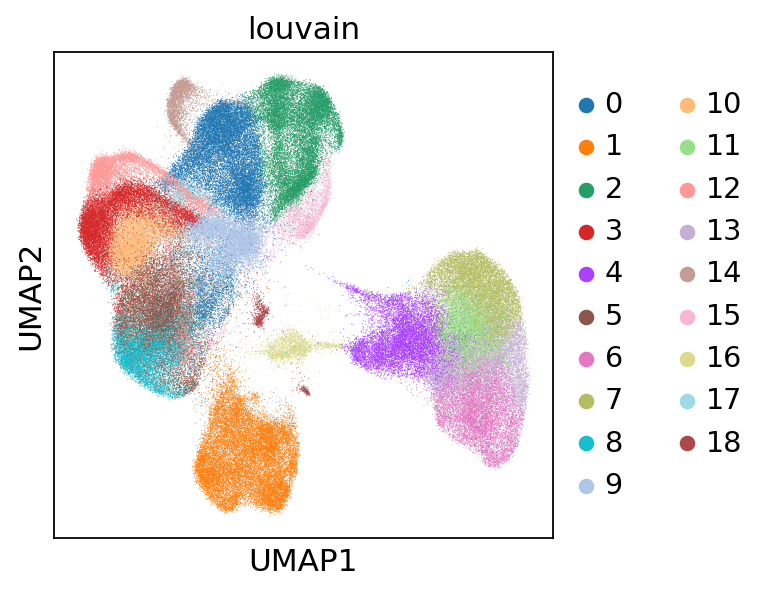

In [12]:
sc.pl.umap(adata_hvg, color=['louvain'])

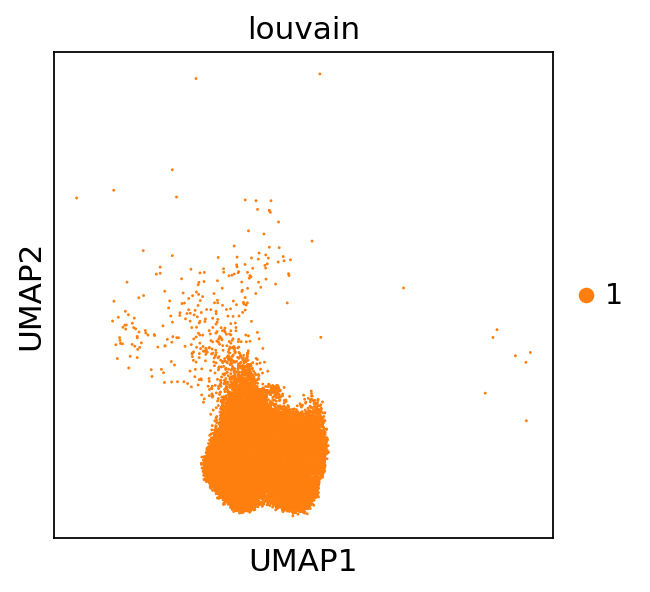

In [13]:
sc.pl.umap(adata_hvg[adata_hvg.obs['louvain'] == '1'], color=['louvain'])

In [14]:
# reading
adata_raw = sc.read(save_path+'adata_raw_filtered.h5ad')

In [15]:
Abs = list(adata_raw[:, adata_raw.var['feature_types-0'] == 'Antibody Capture'].var_names)

In [16]:
len(Abs)

192

In [17]:
for Ab in Abs:
    if 'CD45' in Ab:
        print(Abs.index(Ab))
        print(Ab)

28
CD45RA
38
CD45RO
133
CD45


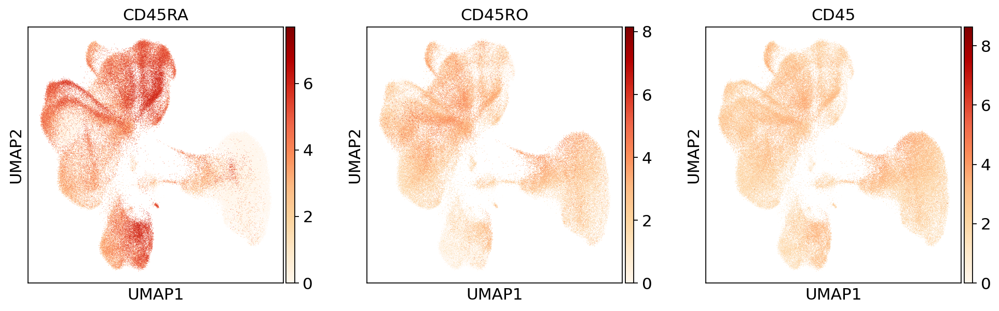

In [51]:
sc.pl.umap(adata_hvg, color=['CD45RA','CD45RO','CD45'], cmap='OrRd',
          #save='_protein_joint_GEX_and_SoupX_denoised_protein_manifold.pdf'
          )

In [175]:
sc.pl.umap(adata_hvg, color=Abs, cmap='OrRd',
          save='_protein_joint_GEX_and_SoupX_denoised_protein_manifold_all_samples.pdf')

KeyboardInterrupt: 

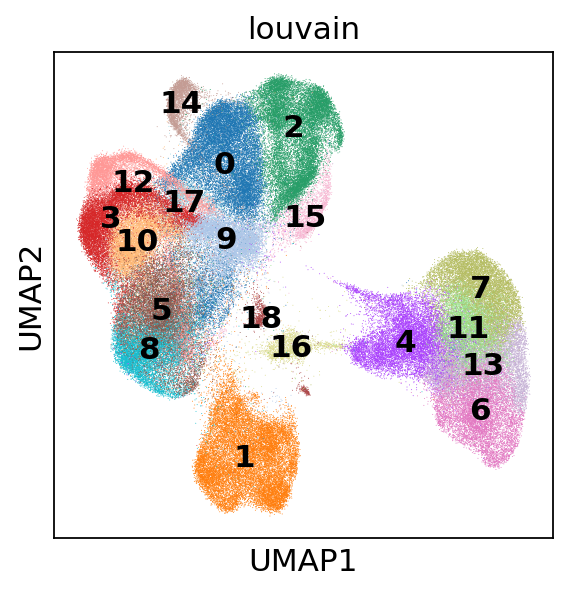

In [52]:
sc.pl.umap(adata_hvg, color=['louvain'], legend_loc = 'on data')

In [53]:
# export indices of B cells and Plasma cells (louvain )
adata_hvg[adata_hvg.obs['louvain'].isin(['1'])].obs.to_csv('./B_cells_indices.csv')

In [20]:
adata_hvg

AnnData object with n_obs × n_vars = 163320 × 2734
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'fe

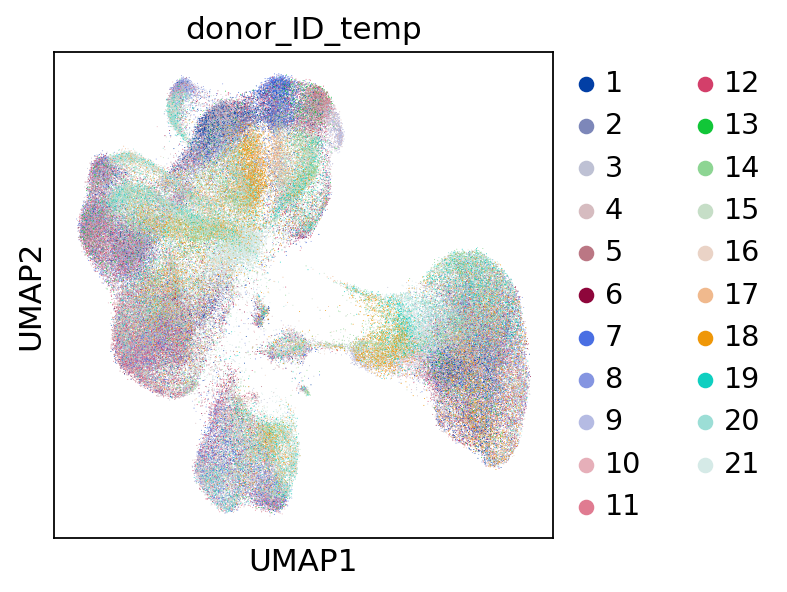

In [24]:
sc.pl.umap(adata_hvg, color='donor_ID_temp')

# Adding final donor IDs from souporcell + deconvoluted values (by Eduardo from VCFs)

In [26]:
adata_hvg.obs['barcode']

AAACCTGAGAATGTGT-1        AAACCTGAGAATGTGT-1
AAACCTGAGACTAAGT-1        AAACCTGAGACTAAGT-1
AAACCTGAGCCGCCTA-1        AAACCTGAGCCGCCTA-1
AAACCTGAGCGCCTCA-1        AAACCTGAGCGCCTCA-1
AAACCTGAGGATGTAT-1        AAACCTGAGGATGTAT-1
                                ...         
TTTGTCATCGCCTGAG-1        TTTGTCATCGCCTGAG-1
TTTGTCATCGTCACGG-1-1    TTTGTCATCGTCACGG-1-1
TTTGTCATCGTCTGCT-1-1    TTTGTCATCGTCTGCT-1-1
TTTGTCATCTACTTAC-1        TTTGTCATCTACTTAC-1
TTTGTCATCTCTTATG-1        TTTGTCATCTCTTATG-1
Name: barcode, Length: 163320, dtype: object

In [90]:
def add_final_donor_labels(adata_obj, barcode):
    
    curr_temp_donor_ID = adata_obj.obs.loc[barcode, 'donor_ID_temp']
    
    if curr_temp_donor_ID == '1':
        return('CVID33')
    elif curr_temp_donor_ID == '2':
        return('CVID34')
    elif curr_temp_donor_ID == '3':
        return('CVID3')
    elif curr_temp_donor_ID == '4':
        return('CONTROL_twin')
    elif curr_temp_donor_ID == '5':
        return('CONTROL6')
    elif curr_temp_donor_ID == '6':
        return('CONTROL4')
    elif curr_temp_donor_ID == '7':
        return('CVID18')
    elif curr_temp_donor_ID == '8':
        return('CVID29')
    elif curr_temp_donor_ID == '9':
        return('CVID_twin')
    elif curr_temp_donor_ID == '10':
        return('CONTROL3')
    elif curr_temp_donor_ID == '11':
        return('CONTROL5')
    elif curr_temp_donor_ID == '12':
        return('CONTROL2')
    elif curr_temp_donor_ID == '13':
        return('CONTROL1')
    elif curr_temp_donor_ID == '14':
        return('CVID1')
    elif curr_temp_donor_ID == '15':
        return('CONTROL9')
    elif curr_temp_donor_ID == '16':
        return('CONTROL7')
    elif curr_temp_donor_ID == '17':
        return('CVID36')
    elif curr_temp_donor_ID == '18':
        return('CVID37')
    elif curr_temp_donor_ID == '19':
        return('CONTROL8')
    elif curr_temp_donor_ID == '20':
        return('CVID23')
    elif curr_temp_donor_ID == '21':
        return('CVID25')
    
    else:
        return('none')

In [91]:
adata_hvg.obs['donor'] = adata_hvg.obs['barcode'].apply(lambda x: add_final_donor_labels(adata_hvg, x))

... storing 'donor' as categorical


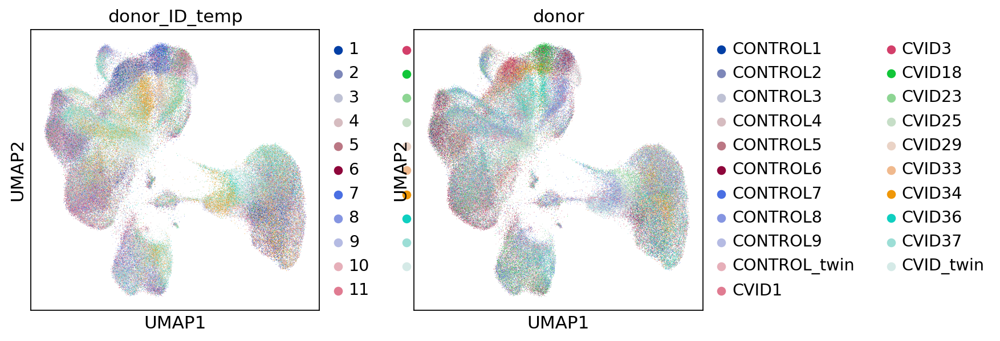

In [92]:
sc.pl.umap(adata_hvg, color=['donor_ID_temp','donor'])

## Preparing the object for cellxgene

In [93]:
# in raw are the normalised and log transformed GEX counts + normalised and log transformed SoupX-denoised protein counts
adata_full = anndata.AnnData(X=adata_hvg.raw.X,
                            obs=adata_hvg.obs,
                            var=adata_hvg.raw.var,
                            obsm=adata_hvg.obsm)

In [94]:
adata_full

AnnData object with n_obs × n_vars = 163320 × 22144
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_i

In [95]:
# get all the clinical metadata
metadata = pd.read_csv('../metadata/Supp_Table2_clinical_information LdPM.csv', header=1, index_col=0)

In [96]:
metadata

,CVID1,CVID3,CVID18,CVID23,CVID25,CVID29,CVID33,CVID34,CVID36,CVID37,...,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10
Age,66,34,33,50,34,22,36,66,31,42,...,19,42,34,52,37,33,37,31,28,31
Sex,female,male,male,male,male,male,male,male,male,male,...,female,male,male,male,female,female,male,male,female,male
Age of disease onset,30,4,19,21,4,8,31,64,25,40,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Autoimmunity,Yes (vitiligo),No,Yes (celiac disease),No,No,No,Yes (diabetes),Yes (ITP),No,Yes (ITP),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gastrointestinal disease,No,No,Yes,No,No,No,No,Yes,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lung disease (bronchiectasis),Yes,Yes,No,No,Yes,No,No,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lymphoadenopathy,Yes,No,Yes,Yes,Yes,No,Yes,Yes,No,Yes,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Splenomegaly,Yes,No,Yes,Yes,Yes,No,Yes,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members",No,No,No,No,No,"Yes, mother IgA deficiency",No,No,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [97]:
metadata.columns

Index(['CVID1 ', 'CVID3', 'CVID18', 'CVID23', 'CVID25', 'CVID29', 'CVID33',
       'CVID34', 'CVID36', 'CVID37', 'CVID twin', 'Control twin', 'C1', 'C2',
       'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10'],
      dtype='object')

In [98]:
new_columns = ['CVID1', 'CVID3', 'CVID18', 'CVID23', 'CVID25', 'CVID29', 'CVID33',
       'CVID34', 'CVID36', 'CVID37', 'CVID_twin', 'CONTROL_twin', 'CONTROL1', 'CONTROL2',
       'CONTROL3', 'CONTROL4', 'CONTROL5', 'CONTROL6', 'CONTROL7', 'CONTROL8', 'CONTROL9', 'CONTROL10']
metadata.columns = new_columns

In [99]:
metadata

,CVID1,CVID3,CVID18,CVID23,CVID25,CVID29,CVID33,CVID34,CVID36,CVID37,...,CONTROL1,CONTROL2,CONTROL3,CONTROL4,CONTROL5,CONTROL6,CONTROL7,CONTROL8,CONTROL9,CONTROL10
Age,66,34,33,50,34,22,36,66,31,42,...,19,42,34,52,37,33,37,31,28,31
Sex,female,male,male,male,male,male,male,male,male,male,...,female,male,male,male,female,female,male,male,female,male
Age of disease onset,30,4,19,21,4,8,31,64,25,40,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Autoimmunity,Yes (vitiligo),No,Yes (celiac disease),No,No,No,Yes (diabetes),Yes (ITP),No,Yes (ITP),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gastrointestinal disease,No,No,Yes,No,No,No,No,Yes,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lung disease (bronchiectasis),Yes,Yes,No,No,Yes,No,No,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lymphoadenopathy,Yes,No,Yes,Yes,Yes,No,Yes,Yes,No,Yes,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Splenomegaly,Yes,No,Yes,Yes,Yes,No,Yes,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members",No,No,No,No,No,"Yes, mother IgA deficiency",No,No,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [100]:
metadata.index

Index([                                                                                         'Age',
                                                                                                'Sex',
                                                                               'Age of disease onset',
                                                                                       'Autoimmunity',
                                                                           'Gastrointestinal disease',
                                                                      'Lung disease (bronchiectasis)',
                                                                                  'Lymphoadenopathy ',
                                                                                       'Splenomegaly',
       'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members',
                                                                         

In [101]:
# dropping rows with only nans
rows2keep = [                                                                                         'Age',
                                                                                                'Sex',
                                                                               'Age of disease onset',
                                                                                       'Autoimmunity',
                                                                           'Gastrointestinal disease',
                                                                      'Lung disease (bronchiectasis)',
                                                                                  'Lymphoadenopathy ',
                                                                                       'Splenomegaly',
       'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members']


metadata = metadata.loc[rows2keep,:]

In [102]:
metadata

,CVID1,CVID3,CVID18,CVID23,CVID25,CVID29,CVID33,CVID34,CVID36,CVID37,...,CONTROL1,CONTROL2,CONTROL3,CONTROL4,CONTROL5,CONTROL6,CONTROL7,CONTROL8,CONTROL9,CONTROL10
Age,66,34,33,50,34,22,36,66,31,42,...,19,42,34,52,37,33,37,31,28,31
Sex,female,male,male,male,male,male,male,male,male,male,...,female,male,male,male,female,female,male,male,female,male
Age of disease onset,30,4,19,21,4,8,31,64,25,40,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Autoimmunity,Yes (vitiligo),No,Yes (celiac disease),No,No,No,Yes (diabetes),Yes (ITP),No,Yes (ITP),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gastrointestinal disease,No,No,Yes,No,No,No,No,Yes,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lung disease (bronchiectasis),Yes,Yes,No,No,Yes,No,No,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lymphoadenopathy,Yes,No,Yes,Yes,Yes,No,Yes,Yes,No,Yes,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Splenomegaly,Yes,No,Yes,Yes,Yes,No,Yes,Yes,Yes,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members",No,No,No,No,No,"Yes, mother IgA deficiency",No,No,No,No,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [103]:
def add_clinical_metadata(adata_obj, barcode, clinical_meta_row):
    
    curr_donor = adata_obj.obs.loc[barcode, 'donor']
    
    value = metadata.loc[clinical_meta_row, curr_donor]
    
    return(value)
    

In [104]:
for col2add in metadata.index:
    print(col2add)
    adata_full.obs[col2add] = adata_full.obs['barcode'].apply(lambda x: add_clinical_metadata(adata_full, x, col2add))

Age
Sex
Age of disease onset
Autoimmunity
Gastrointestinal disease
Lung disease (bronchiectasis)
Lymphoadenopathy 
Splenomegaly
History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members


In [109]:
np.unique(adata_full.obs['donor'])

array(['CONTROL1', 'CONTROL2', 'CONTROL3', 'CONTROL4', 'CONTROL5',
       'CONTROL6', 'CONTROL7', 'CONTROL8', 'CONTROL9', 'CONTROL_twin',
       'CVID1', 'CVID18', 'CVID23', 'CVID25', 'CVID29', 'CVID3', 'CVID33',
       'CVID34', 'CVID36', 'CVID37', 'CVID_twin'], dtype=object)

In [110]:
# also adding general key of CVID status
adata_full.obs['CVID_status'] = ['CVID' if 'CVID' in donor else 'CONTROL' for donor in adata_full.obs['donor']]

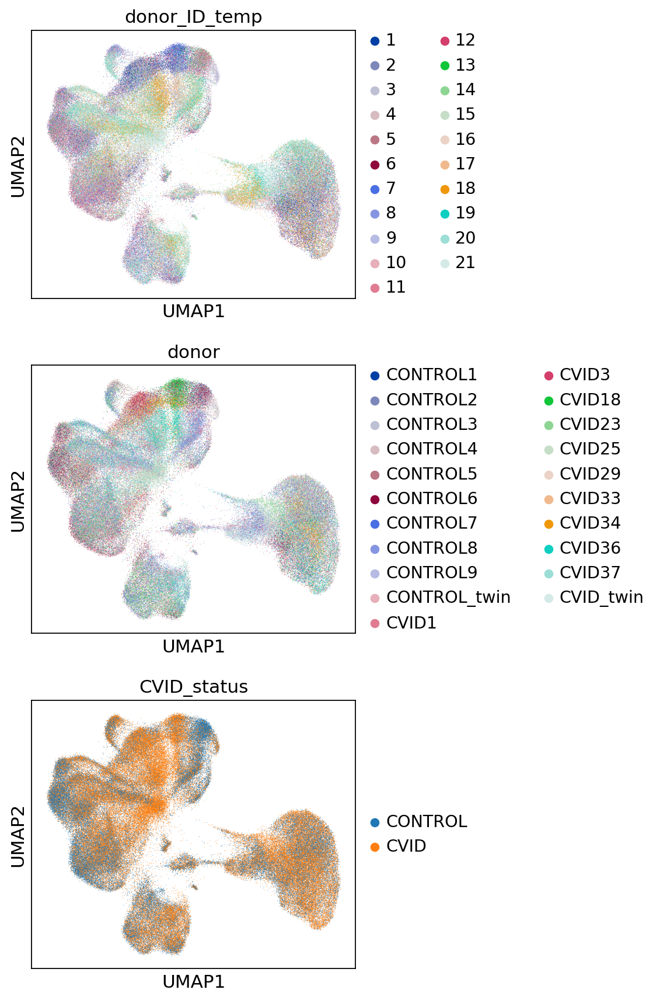

In [113]:
sc.pl.umap(adata_full, color=['donor_ID_temp','donor','CVID_status'], ncols=1)

In [114]:
# saving this .obs table to use on the B cell object also
adata_full.obs.to_csv(save_path + '20210104_obs_table_final_object.csv')

In [116]:
import scipy
adata_full.X = scipy.sparse.csc_matrix(adata_full.X)


In [117]:
adata_full.obs.columns

Index(['n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito',
       'n_counts', 'dataset', 'technique', 'scrublet_score',
       'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode',
       'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score',
       'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate',
       'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24',
       'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot',
       'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex',
       'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease',
       'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly',
       'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members',
       'CVID_status'],
      dtype='object')

In [122]:
categ_columns = ['stimulation',
                 'sample',
                 'dataset',
                 'batch',
                 'is_doublet',
                 'phase',
                 'louvain',
                 'celltype_predictions',
                 'donor',
                 'Sex',
                 'Autoimmunity', 
                 'Gastrointestinal disease',
                 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly',
                 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members',
                 'CVID_status',
                ]


cont_columns = ['n_genes',
                'percent_mito',
                'n_counts',
                'scrublet_score',
                'scrublet_cluster_score', 
                'bh_pval',
                'S_score', 'G2M_score',
                'is_doublet',
                'is_doublet_propagate',
                'probabilities',
                'n_counts_protein',
                'n_counts_protein_lognorm',
                'Age',    
                
               ]


In [123]:
import pandas
for column in categ_columns:
    adata_full.obs[column] = pd.Categorical(adata_full.obs[column])
    
for column in cont_columns:
    adata_full.obs[column] = np.float32(adata_full.obs[column])

In [124]:
Abs = adata_full.var[adata_full.var['feature_types-0'] == 'Antibody Capture'].index

In [127]:
len(Abs)

192

In [125]:
new_var_names = [elem + '_protein' if elem in Abs else elem for elem in adata_full.var_names]

In [126]:
for elem in new_var_names:
    if '_protein' in elem:
        print(elem)

B7-H4_protein
CD10_protein
CD101(BB27)_protein
CD103(IntegrinaE)_protein
CD106_protein
CD107a(LAMP-1)_protein
CD112(Nectin-2)_protein
CD117(c-kit)_protein
CD11a_protein
CD11b_protein
CD11c_protein
CD122(IL-2RB)_protein
CD123_protein
CD124(IL-4Ra)_protein
CD127(IL-7Ra)_protein
CD133_protein
CD137(4-1BB)_protein
CD137L(4-1BBLigand)_protein
CD138(Syndecan-1)_protein
CD14-1_protein
CD141(Thrombomodulin)_protein
CD144(VE-Cadherin)_protein
CD146_protein
CD15(SSEA-1)_protein
CD150(SLAM)_protein
CD152(CTLA-4)_protein
CD154_protein
CD155(PVR)_protein
CD158(KIR2DL1/S1/S3/S5)_protein
CD158b(KIR2DL2)_protein
CD158e1(KIR3DL1)_protein
CD158f(KIR2DL5)_protein
CD16_protein
CD161_protein
CD163-1_protein
CD169(Sialoadhesin)_protein
CD178(Fas-L)_protein
CD18_protein
CD183(CXCR3)_protein
CD184(CXCR4)_protein
CD185(CXCR5)_protein
CD19-1_protein
CD193(CCR3)_protein
CD194(CCR4)_protein
CD195(CCR5)_protein
CD196(CCR6)_protein
CD197(CCR7)_protein
CD1a_protein
CD1c_protein
CD1d_protein
CD2-1_protein
CD20_protei

In [128]:
adata_full.var_names = new_var_names

In [129]:
adata_full.var.index = new_var_names

In [130]:
adata_full.write(save_path+'adata_for_cellxgene_GEX_and_SoupX_denoised_protein_BBKNN_all_samples_20210104.h5ad')

In [132]:
save_path+'adata_for_cellxgene_GEX_and_SoupX_denoised_protein_BBKNN_all_samples_20210104.h5ad'

'/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/adata_for_cellxgene_GEX_and_SoupX_denoised_protein_BBKNN_all_samples_20210104.h5ad'

In [133]:
adata_full

AnnData object with n_obs × n_vars = 163320 × 22144
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'donor_ID_temp', 'louvain', 'is_doublet_propagate', 'probabilities', 'celltype_predictions', 'louvain_R_16', 'louvain_R_24', 'louvain_R_0', 'louvain_R_9', 'louvain_R_1', 'prelim_annot', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome